# Bayesian Calibration Using Raul's Processed Data

In this notebook, we do the full Bayesian calibration fit that *may* end up in the final paper, using data that went into the Nature Paper, processed by Raul. 

## Data Loading and Import

In [53]:
import h5py
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
from edges_cal import modelling as mdl
from edges_analysis.analysis import averaging
from edges_analysis import read_step
from pathlib import Path
from edges_analysis.analysis import s11 as s11m
from edges_cal import receiver_calibration_func as rcf
from yabf import load_likelihood_from_yaml
from edges_estimate.generate import create_calibration_config_from_calobs
from getdist import loadMCSamples
from yabf import ParamVec
from edges_analysis.analysis.calibrate import LabCalibration
from edges_estimate.eor_models import AbsorptionProfile
from edges_estimate.fitting import SemiLinearFit
from edges_cal.modelling import NoiseWaves, LinLog, Polynomial, UnitTransform
from yabf.core.samplers import run_map
from edges_estimate.likelihoods import NoiseWaveLikelihood, DataCalibrationLikelihood
from edges_cal import CalibrationObservation
from scipy import stats
from yabf.samplers.emcee import emcee

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [54]:
# Setup plotting for MNRAS
plt.rcParams['axes.facecolor'] = 'white'
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['figure.dpi'] = 600

single_width = 3.377  # inches
double_width = 7.03   # inches

In [55]:
with h5py.File("rauls-unaveraged-np-data-v3.hdf5", 'r') as fl:
    print(fl.keys())
    gha_edges = fl['gha_edges'][...]
    freq = fl['frequency'][...]
    spec = fl['temperature_yes_corrected'][...]
    weights = fl['weights'][...]
    spec_nobeam = fl['temperature_not_corrected'][...]

<KeysViewHDF5 ['frequency', 'gha_edges', 'gha_list', 'temperature_not_corrected', 'temperature_yes_corrected', 'weights']>


In [8]:
np_data = np.genfromtxt("/home/smurray/data4/Projects/radio/EOR/Edges/projects_with_nive/edges-bowman2018-pipeline/figure1_plotdata.csv", skip_header=True, delimiter=',')
np_wght = np_data[:, 1]

np_freq = np_data[np_wght > 0, 0]
np_tsky = np_data[np_wght > 0, 2]

## Inspect Data

Text(0, 0.5, 'GHA')

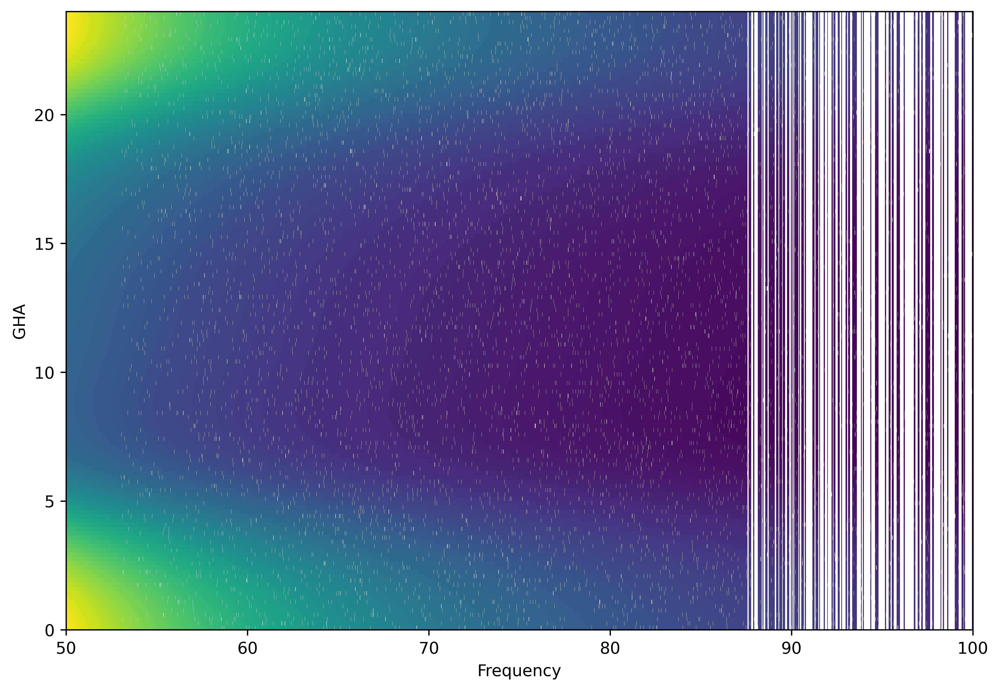

In [14]:
plt.figure(figsize=(10, 7))
plt.imshow(np.where(weights==0, np.nan, spec), origin='lower', aspect='auto', extent=(freq.min(), freq.max(), gha_edges.min(), gha_edges.max()), interpolation='none')
plt.xlabel("Frequency")
plt.ylabel("GHA")

There is a *lot* of flagging going on here.

In [56]:
linlog5 = mdl.LinLog(n_terms=5).at(x=freq)

In [16]:
np_resid = mdl.LinLog(n_terms=5, default_x=np_freq).fit(np_tsky).residual

In [57]:
model_params = []
resids = np.zeros_like(spec)

for i, (s,w) in enumerate(zip(spec, weights)):
    fit = linlog5.fit(ydata=s, weights=w)
    model_params.append(fit.model_parameters)
    resids[i] = fit.residual

In [18]:
model_params_unc = []
resids_unc = np.zeros_like(spec)

for i, (s,w) in enumerate(zip(spec_nobeam, weights)):
    fit = linlog5.fit(ydata=s, weights=w)
    model_params_unc.append(fit.model_parameters)
    resids_unc[i] = fit.residual

In [19]:
plt.figure(figsize=(10, 25))

fb, wb, sb, rb, pb = averaging.bin_freq_unbiased_regular(
    model_type = mdl.LinLog,
    params=model_params,
    freq=freq,
    resids=resids,
    weights=weights,
    resolution=0.4,
    n_terms=5
)

for i, (r, w) in enumerate(zip(rb, wb)):
    plt.plot(fb, -i + np.where(w, r, np.nan), color='k')

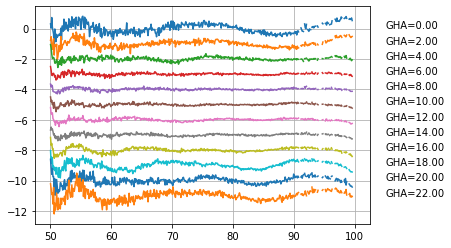

In [12]:
new_gha_bins = np.arange(0, 25, 2)

fb, rb, wb, sb, pb = averaging.bin_spectrum_unbiased_regular(
    params=np.array(model_params),
    resids=resids,
    weights=weights,
    gha= (gha_edges[1:] + gha_edges[:-1])/2,
    gha_bins = new_gha_bins,
    model_type='linlog',
    freq=freq,
    resolution=0.1,
    n_terms=5,
)

for i, rr in enumerate(rb): 
    plt.plot(fb, -i + rr, label=f'GHA={i*2}')
    plt.text(
        fb.max() + 5,
        -i,
        f"GHA={new_gha_bins[i]:.2f}"
    )
plt.grid(True) 
# plt.legend(ncol=2)

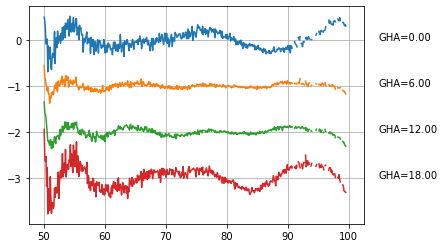

In [13]:
new_gha_bins = np.arange(0, 25, 6)

fb, rb, wb, sb, pb = averaging.bin_spectrum_unbiased_regular(
    params=np.array(model_params),
    resids=resids,
    weights=weights,
    gha= (gha_edges[1:] + gha_edges[:-1])/2,
    gha_bins = new_gha_bins,
    model_type='linlog',
    freq=freq,
    resolution=0.1,
    n_terms=5,
)

for i, rr in enumerate(rb): 
    plt.plot(fb, -i + rr, label=f'GHA={i*2}')
    plt.text(
        fb.max() + 5,
        -i,
        f"GHA={new_gha_bins[i]:.2f}"
    )
plt.grid(True) 

Text(0.5, 1.0, 'GHA=6-18')

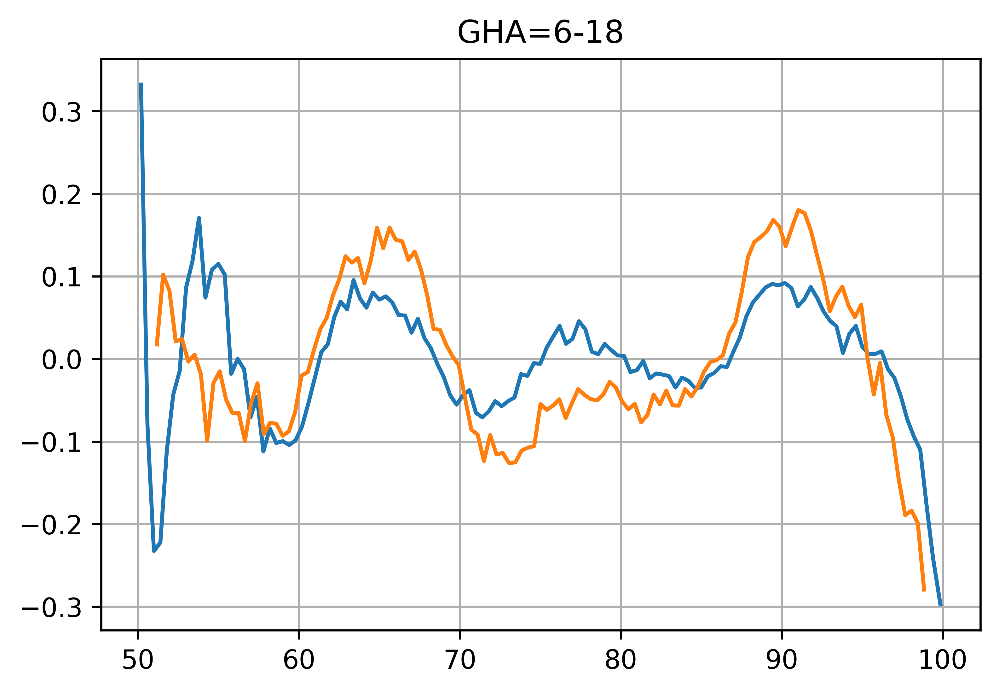

In [31]:
new_gha_bins = np.array([6, 18])

f400, rb, wfinal, sfinal, pb = averaging.bin_spectrum_unbiased_regular(
    params=np.array(model_params),
    resids=resids,
    weights=weights,
    gha= (gha_edges[1:] + gha_edges[:-1])/2,
    gha_bins = new_gha_bins,
    model_type='linlog',
    freq=freq,
    resolution=0.4,
    n_terms=5,
)

plt.plot(f400, rb[0], label=f"Raul's Data")
plt.plot(np_freq, np_resid, label='Online NP Data')
# plt.plot(np_freq, np_tsky - linlog5(x=np_freq, parameters=pb[0]))
plt.grid(True)
plt.title("GHA=6-18")

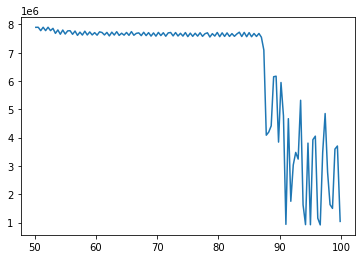

In [15]:
plt.plot(f400, wfinal[0])

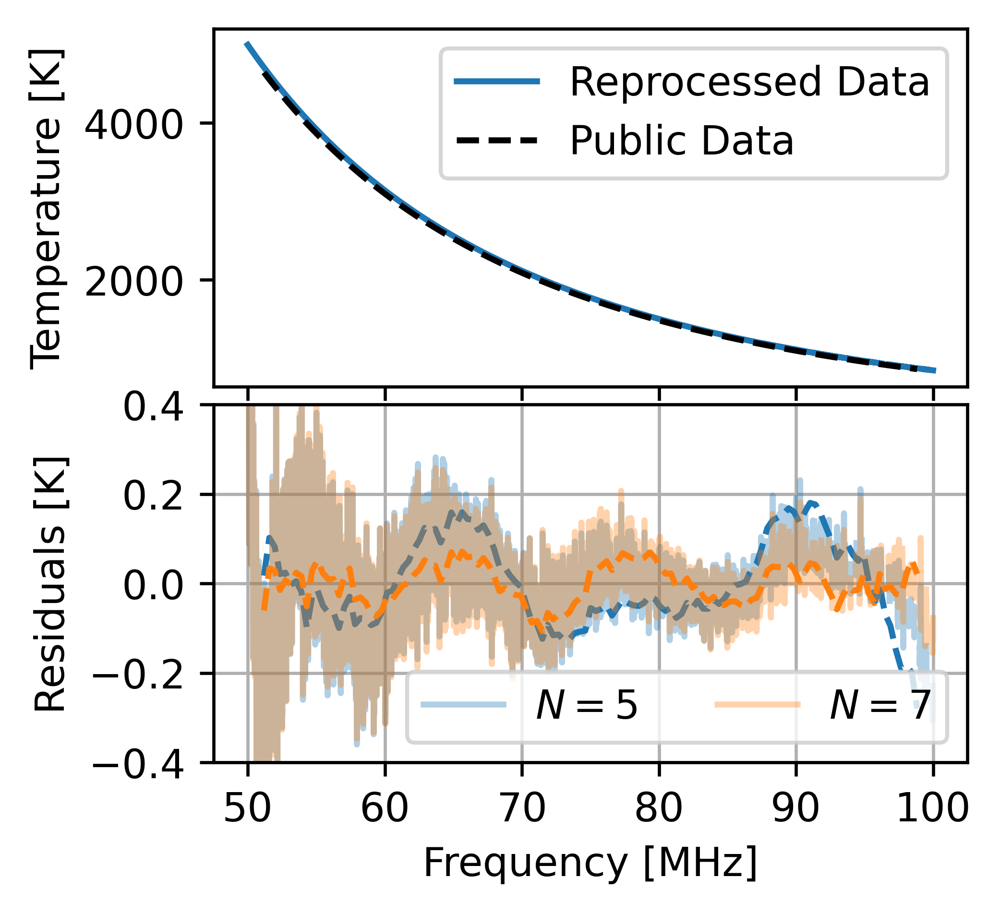

In [58]:
new_gha_bins = np.array([6,18])

f, rb, wfinal, sfinal, pb = averaging.bin_spectrum_unbiased_regular(
    params=np.array(model_params),
    resids=resids,
    weights=weights,
    gha= (gha_edges[1:] + gha_edges[:-1])/2,
    gha_bins = new_gha_bins,
    model_type='linlog',
    freq=freq,
    resolution=0,
    n_terms=5,
)

fig, ax = plt.subplots(2, 1, sharex=True, figsize=(single_width, single_width), gridspec_kw={"hspace": 0.05}, )

ax[0].plot(f, sfinal[0], label='Reprocessed Data')
ax[0].plot(np_freq, np_tsky, label='Public Data', ls='--', color='k')

ax[1].set_xlabel("Frequency [MHz]")
ax[0].set_ylabel("Temperature [K]")


for i, n_terms in enumerate([5, 7]):
    linlog = mdl.LinLog(n_terms=n_terms, default_x=f)
    res = linlog.fit(ydata=sfinal[0], weights=wfinal[0]).residual
    
    np_resid = mdl.LinLog(n_terms=n_terms, default_x=np_freq).fit(np_tsky).residual
    
    ax[1].plot(f, res, label=r"$N=%s$"%n_terms, alpha=0.35, color=f"C{i}")
    
    # plt.plot(np_freq, np_tsky - linlog5(x=np_freq, parameters=pb[0]))
    plt.grid(True)

    ax[1].plot(np_freq, np_resid, ls='--', color=f'C{i}')

ax[1].set_ylabel("Residuals [K]")
ax[0].legend()
ax[1].legend(ncol=2)
ax[1].set_ylim(-0.4, 0.4)
#ax[1].yaxis.set_ticklabels([]);
plt.savefig("comparison_to_np_data.pdf")

### Fit Absorption

In [58]:
from edges_estimate.eor_models import AbsorptionProfile
from edges_estimate.fitting import SemiLinearFit

In [59]:
def make_absorption(freq, fix=tuple()):
    params={
        'A': {'max':2, 'min': 0.05, 'fiducial': 0.5}, 
        'nu0': {'min': 60, 'max': 90, 'fiducial': 78.5}, 
        'tau': {'min': 1, 'max': 20, 'fiducial': 7}, 
        'w': {'min':1, 'max': 25, 'fiducial': 15}
    }
    
    fid = {}
    for p in fix:
        fid[p] = params.pop(p)['fiducial']
        
    return AbsorptionProfile(
        name='absorption',
        fiducial=fid,
        params=params,
        freqs=freq
    )

In [10]:
spec = sfinal[0][(f400>55) & (f400 <95)]
ff = f400[(f400>55) & (f400 <95)]

eor = make_absorption(ff, fix=['tau'])
linlog = mdl.LinLog(n_terms=5, default_x=ff)

slf = SemiLinearFit(linlog, eor, spec, 1)
res = slf()

NameError: name 'f400' is not defined

In [100]:
res

      fun: 91.91423192331541
 hess_inv: <3x3 LbfgsInvHessProduct with dtype=float64>
      jac: array([ 4.54747349e-05,  4.26325909e-06, -7.10542677e-06])
  message: b'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 92
      nit: 22
     njev: 23
   status: 0
  success: True
        x: array([ 0.52028168, 77.7793909 , 20.55796271])

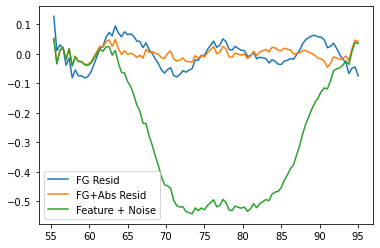

In [101]:
plt.plot(ff, slf.get_resid([0, 75, 20]), label="FG Resid")
plt.plot(ff, slf.get_resid(res.x), label="FG+Abs Resid")
plt.plot(ff, slf.get_eor(res.x) + slf.get_resid(res.x), label="Feature + Noise")
plt.legend()

In [102]:
mask = (f400>53) & (f400 <97)
spec = sfinal[0][mask]
ff = f400[mask]

eor = make_absorption(ff, fix=['tau'])
linlog = mdl.LinLog(n_terms=7, default_x=ff)

slf = SemiLinearFit(linlog, eor, spec, 1)
res = slf()

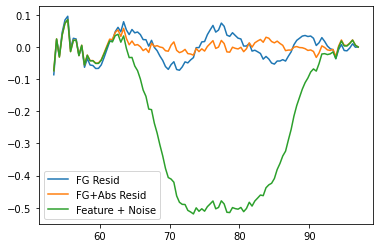

In [103]:
plt.plot(ff, slf.get_resid([0, 75, 20]), label="FG Resid")
plt.plot(ff, slf.get_resid(res.x), label="FG+Abs Resid")
plt.plot(ff, slf.get_eor(res.x) + slf.get_resid(res.x), label="Feature + Noise")
plt.legend()

In [104]:
mask = (f400>60) & (f400 <100)
spec = sfinal[0][mask]
ff = f400[mask]

eor = make_absorption(ff, fix=['tau'])
linlog = mdl.LinLog(n_terms=7, default_x=ff)

slf = SemiLinearFit(linlog, eor, spec, 1)
res = slf()

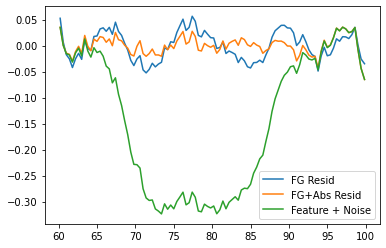

In [105]:
plt.plot(ff, slf.get_resid([0, 75, 20]), label="FG Resid")
plt.plot(ff, slf.get_resid(res.x), label="FG+Abs Resid")
plt.plot(ff, slf.get_eor(res.x) + slf.get_resid(res.x), label="Feature + Noise")
plt.legend()

In [106]:
mask = (f400>60) & (f400 <98)
spec = sfinal[0][mask]
ff = f400[mask]

eor = make_absorption(ff, fix=['tau'])
linlog = mdl.LinLog(n_terms=7, default_x=ff)

slf = SemiLinearFit(linlog, eor, spec, 1)
res = slf()

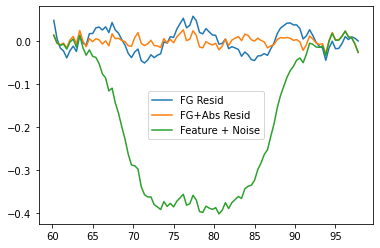

In [107]:
plt.plot(ff, slf.get_resid([0, 75, 20]), label="FG Resid")
plt.plot(ff, slf.get_resid(res.x), label="FG+Abs Resid")
plt.plot(ff, slf.get_eor(res.x) + slf.get_resid(res.x), label="Feature + Noise")
plt.legend()

In [76]:
np_eor = make_absorption(np_freq, fix=['tau'])
np_linlog = mdl.LinLog(n_terms=5, default_x=np_freq)

np_slf = SemiLinearFit(np_linlog, np_eor, np_tsky, 1)
np_res = np_slf()

In [77]:
np_res

      fun: 113.06437962974752
 hess_inv: <3x3 LbfgsInvHessProduct with dtype=float64>
      jac: array([-1.13686837e-05, -1.42108636e-05, -2.13162803e-05])
  message: b'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 56
      nit: 9
     njev: 14
   status: 0
  success: True
        x: array([ 0.5583004 , 78.17110675, 18.65392167])

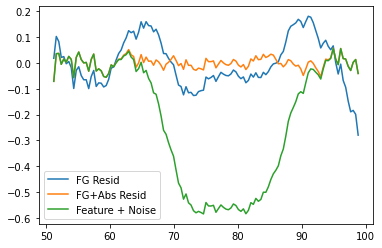

In [44]:
plt.plot(np_freq, np_resid, label="FG Resid")
plt.plot(np_freq, np_slf.get_resid(np_res.x), label="FG+Abs Resid")
plt.plot(np_freq, np_slf.get_eor(np_res.x) + np_slf.get_resid(np_res.x), label="Feature + Noise")
plt.legend()

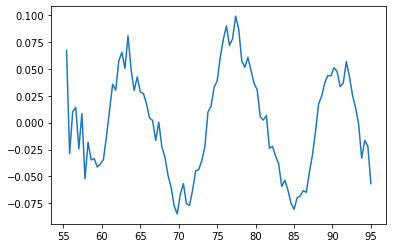

In [16]:
plt.plot(ff, linlog.fit(spec).residual);

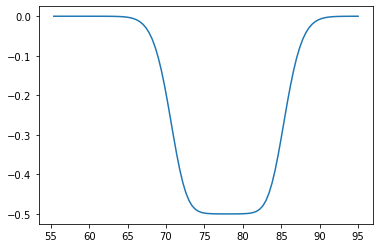

In [23]:
plt.plot(ff, slf.get_eor([0.5]))

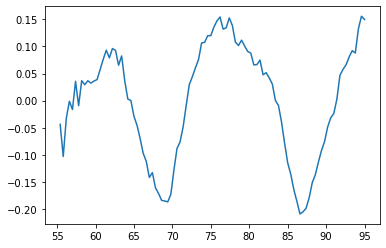

In [22]:
plt.plot(ff, slf.get_resid([0.5]))

In [17]:
res

      fun: 92.00739782901346
 hess_inv: <1x1 LbfgsInvHessProduct with dtype=float64>
      jac: array([0.07233467])
  message: b'CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL'
     nfev: 4
      nit: 1
     njev: 2
   status: 0
  success: True
        x: array([0.])

In [ ]:
plt.plot(freq2,)

### Compare to edges-analysis

In [4]:
from edges_analysis.analysis import BinnedData

In [5]:
eadata = read_step("/home/smurray/edges/Steven/edges-cache/level-cache/nature-paper/no-rms/linlog5-25/bin05-xrfi-model/all-days-with-xrfi/all-files.h5")

In [6]:
new = BinnedData.promote(
    eadata, 
    f_low=52.,
    freq_resolution=0.5,
    gha_bin_size=1.0
)

(<class 'edges_analysis.analysis.levels.DayAveragedData'>, 'self')


/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/tools.py:835: RuntimeWarning: Mean of empty slice
  params_out[i] = np.nanmean(these_params, axis=0)


<AxesSubplot:>

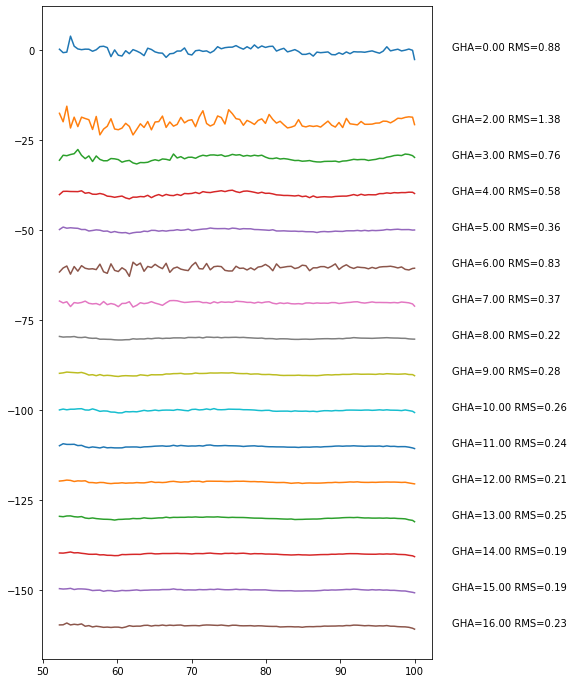

In [7]:
new.plot_resids()

In [192]:
eaf_freqbin, eaw_freqbin, eas_freqbin = bin_in_freq(
    mdl.LinLog, eadata.model_params, eadata.raw_frequencies, eadata.resids, eadata.weights, 
    new_freq_edges=np.linspace(50.5, 100, 100),
    n_terms=5
)

In [193]:
ear_freqbin = np.array([linlog_fb.fit(s,w).residual for s,w in zip(eas_freqbin, eaw_freqbin)])

Text(0.5, 1.0, 'edges-analysis')

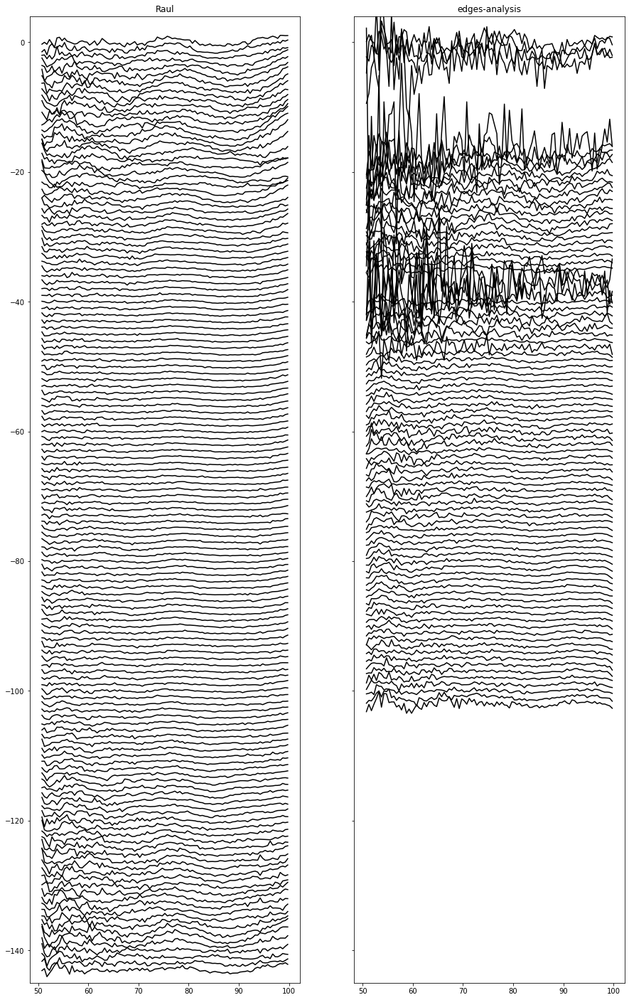

In [199]:
fig, ax = plt.subplots(1,2, figsize=(15, 25), sharey=True)

for i, (r, w) in enumerate(zip(r_freqbin, w_freqbin)):
    ax[0].plot(f_freqbin, -i + np.where(w, r, np.nan), color='k')
    
for i, (r, w) in enumerate(zip(ear_freqbin, eaw_freqbin)):
    ax[1].plot(f_freqbin, -i + np.where(w, r, np.nan), color='k')
    
ax[0].set_ylim(-145, 4)
ax[1].set_ylim(-145, 4)

ax[0].set_title("Raul")
ax[1].set_title("edges-analysis")

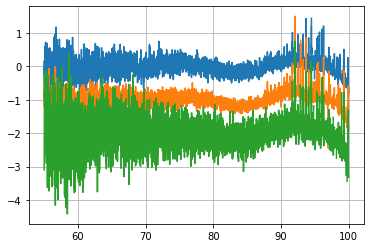

In [215]:
f, r = get_gha_binned_resids(4, f_low=55., model=mdl.LinLog, weights=eadata.weights, resids=eadata.resids, model_params=eadata.model_params, freq=eadata.raw_frequencies)

for i, rr in enumerate(r[2:]): 
    plt.plot(f, -i + rr, label=f'GHA={i*2}')

plt.grid(True)

In [213]:
eaf_freqbin, eaw_freqbin, eas_freqbin = bin_in_freq(
    mdl.LinLog, eadata.model_params, eadata.raw_frequencies, eadata.resids, eadata.weights, 
    new_freq_edges=np.linspace(50.5, 100, 100),
    n_terms=5
)

array([290, 291, 292, 293, 295, 296, 297, 298, 302, 305, 317, 318, 319,
       320, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332, 333, 336,
       337, 338, 340, 341, 342, 343, 344, 345, 346, 349, 350, 351, 352,
       354, 355, 356, 357, 358, 359, 360, 361, 364, 365,   1,   2,   3,
         5,   7,   8,   9,  13,  14,  15,  17,  77,  80,  82,  86,  88,
        90,  91,  92,  93,  93,  94])

In [203]:
linlog5.default_x.shape

(8193,)

In [204]:
freq.shape

(8193,)

In [205]:
freq

array([ 50.        ,  50.00610352,  50.01220703, ...,  99.98779297,
        99.99389648, 100.        ])

In [206]:
eadata.raw_frequencies

array([50.00152593, 50.00762963, 50.01373333, ..., 99.98474075,
       99.99084445, 99.99694815])

## Pure Calibration

### Check out Beam Correction applicaiton

In [60]:
cal_params = np.genfromtxt("for_steven_low_band_1_extended_GP_calibration_parameters.txt")
raul_lna = cal_params[:, 1] + 1j*cal_params[:, 2]

In [61]:
raul_s11_cal = np.genfromtxt(
    "raul_all_s11_calibrated.txt",
    dtype = [
        ('freq', float),
        ('lna_re', float),
        ('lna_im', float),
        ('ambient_re', float),
        ('ambient_im', float),
        ('hot_load_re', float),
        ('hot_load_im', float),
        ('open_re', float),
        ('open_im', float),
        ('short_re', float),
        ('short_im', float),
        ('semi_rigid_s11_re', float),
        ('semi_rigid_s11_im', float),
        ('semi_rigid_s12_re', float),
        ('semi_rigid_s12_im', float),
        ('semi_rigid_s22_re', float),
        ('semi_rigid_s22_im', float),
        ('antsim1_re', float),
        ('antsim1_im', float),
        ('antsim2_re', float),
        ('antims2_im', float),
    ]
)

In [32]:
raul_s11_cal[:, 0]

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

In [97]:
new = np.genfromtxt("raul_calibrated_semi_rigid.txt")

In [100]:
calobs.hot_load._correction.data.shape

(51, 3)

In [6]:
!head -1 for_steven_low_band_1_extended_GP_calibration_parameters.txt

# f, real(s11_LNA), imag(s11_LNA), C1, C2, TU, TC, TS, real(s11_ant), imag(s11_ant), Gconn, Gbalun, Gground


### Cross-Check With Raul's Calibration

In [62]:
from edges_cal import CalibrationObservation
from edges_cal.receiver_calibration_func import get_linear_coefficients

In [63]:
calobs = CalibrationObservation(
    "/data5/edges/data/CalibrationObservations/Receiver01/Receiver01_25C_2015_09_02_040_to_200MHz/", 
    f_low=50.0,
    f_high=100.0,
    run_num={"receiver_reading": 6},
    repeat_num=1,
    cterms=6,
    wterms=5,
    load_kwargs= {"t_load": 300, "t_load_ns": 350},
    load_spectra = {
        "hot_load": {"ignore_times_percent": 10},
        "ambient": {"ignore_times_percent": 7},
        "open": {"ignore_times_percent": 7},
        "short": {"ignore_times_percent": 7},
    },
    load_s11s = {"lna":{'n_terms': 11, 'model_type': 'polynomial'}}
)

calobs_new_semi = CalibrationObservation(
    "/data5/edges/data/CalibrationObservations/Receiver01/Receiver01_25C_2015_09_02_040_to_200MHz/", 
    f_low=50.0,
    f_high=100.0,
    run_num={"receiver_reading": 6},
    repeat_num=1,
    cterms=6,
    semi_rigid_path='raul_calibrated_semi_rigid.txt',
    wterms=5,
    load_kwargs= {"t_load": 300, "t_load_ns": 350},
    load_spectra = {
        "hot_load": {"ignore_times_percent": 10},
        "ambient": {"ignore_times_percent": 7},
        "open": {"ignore_times_percent": 7},
        "short": {"ignore_times_percent": 7},
    },
    load_s11s = {"lna":{'n_terms': 11, 'model_type': 'polynomial'}}
)

labcal = LabCalibration(
    calobs=calobs, s11_files=sorted(Path('/data5/edges/data/S11_antenna/low_band/20160830_a/s11').glob('*.s1p'))
)

labcal_new_semi = LabCalibration(
    calobs=calobs_new_semi, s11_files=sorted(Path('/data5/edges/data/S11_antenna/low_band/20160830_a/s11').glob('*.s1p'))
)


#### LNA S11 CrossCheck

Text(0, 0.5, 'Frac Diff in LNA S11 Amp.')

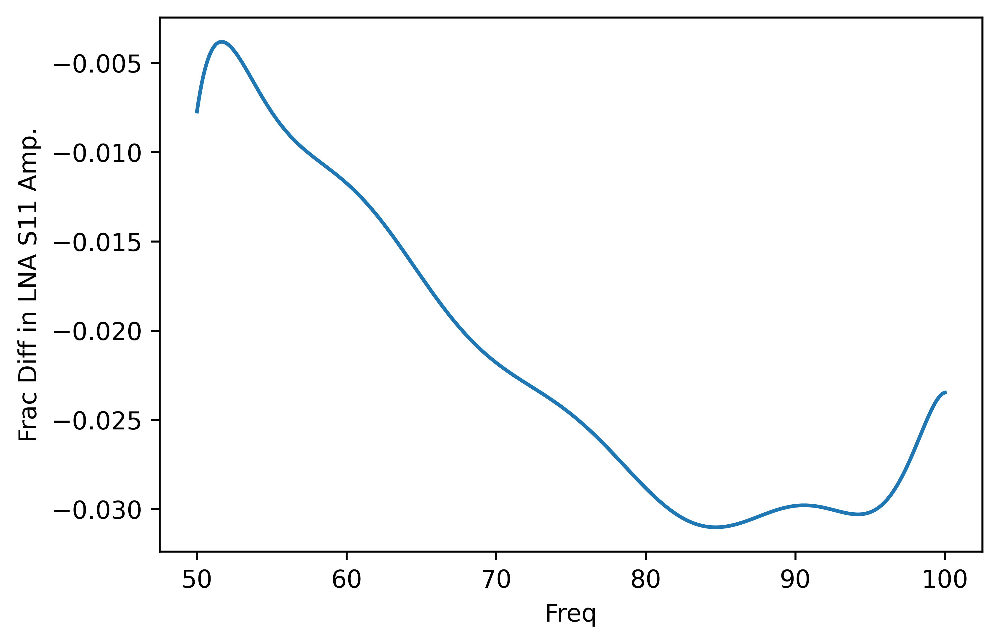

In [25]:
plt.plot(calobs.freq.freq, np.abs(calobs.lna.s11_model(calobs.freq.freq))/np.abs(raul_lna) - 1)
plt.xlabel("Freq")
plt.ylabel("Frac Diff in LNA S11 Amp.")

In [126]:
fig, ax = plt.subplots(4, 2, sharex=True, figsize=(12,12))
ax[0,0].plot(cal_params[:, 0], np.real(raul_lna), label='raul')
ax[1,0].plot(cal_params[:, 0], np.imag(raul_lna))
ax[2,0].plot(cal_params[:, 0], np.abs(raul_lna))
ax[3,0].plot(cal_params[:, 0], np.angle(raul_lna))

ax[1,0].set_ylabel("Imag")
ax[3,0].set_xlabel("Frequency")
ax[0,0].set_ylabel('Real')
ax[2,0].set_ylabel("Abs")
ax[3,0].set_ylabel("Phase")

for run_num in [1,2,4,6,8]:
    clb = CalibrationObservation(
        "/data5/edges/data/CalibrationObservations/Receiver01/Receiver01_25C_2015_09_02_040_to_200MHz/", 
        f_low=50.0,
        f_high=100.0,
        run_num={"receiver_reading": run_num},
        repeat_num=1,
        cterms=6,
        wterms=5,
        load_s11s = {'lna': {'n_terms': 11, 'model_type': 'polynomial'}},
    )

    ax[0,0].plot(clb.freq.freq, np.real(clb.lna.s11_model(clb.freq.freq)), label='mine run %s'%run_num)
    ax[1,0].plot(clb.freq.freq, np.imag(clb.lna.s11_model(clb.freq.freq)))
    ax[2,0].plot(clb.freq.freq, np.abs(clb.lna.s11_model(clb.freq.freq)))
    ax[3,0].plot(clb.freq.freq, np.angle(clb.lna.s11_model(clb.freq.freq)))
    
    ax[0,1].plot(cal_params[:, 0], np.real(clb.lna.s11_model(cal_params[:, 0])) - np.real(raul_lna), label='run %s'%run_num)
    ax[1,1].plot(cal_params[:, 0], np.imag(clb.lna.s11_model(cal_params[:, 0])) - np.imag(raul_lna))
    ax[2,1].plot(cal_params[:, 0], np.abs(clb.lna.s11_model(cal_params[:, 0])) - np.abs(raul_lna))
    ax[3,1].plot(cal_params[:, 0], np.angle(clb.lna.s11_model(cal_params[:, 0])) - np.angle(raul_lna))
    
fig.suptitle("LNA S11 Model")    
ax[0, 0].legend()
ax[0, 1].legend()

Error in callback <function flush_figures at 0x7fa2b851b8c8> (for post_execute):


KeyboardInterrupt: 

#### Calibration Parameters Cross-Check

In [64]:
def plot_coefficient_comparison(calobss, with_total_effects=True, sfinal=None, inject_ant_s11=None):

    fig, ax = plt.subplots(6 if with_total_effects else 5, 4 if with_total_effects else 2, sharex=True, figsize=(single_width*5, 10)) 
    inject_ant_s11 = inject_ant_s11 or []
    
    for j, (name, calobs) in enumerate(calobss.items()):
        ls=['-','--','-.',':'][j%4]
        
        ax[0, 0].plot(calobs.freq.freq, calobs.C1(), label=name, ls=ls)    
        ax[0, 1].plot(calobs.freq.freq, calobs.C1()/cal_params[:, 3] -1, ls=ls)
        ax[0, 0].set_ylabel("C1")

        ax[1, 0].plot(calobs.freq.freq, calobs.C2(), ls=ls)
        ax[1, 1].plot(calobs.freq.freq, calobs.C2()/cal_params[:, 4] -1, ls=ls)
        ax[1, 0].set_ylabel("C2")

        ax[2, 0].plot(calobs.freq.freq, calobs.Tunc(), ls=ls)
        ax[2, 1].plot(calobs.freq.freq, calobs.Tunc()/cal_params[:, 5] -1, ls=ls)
        ax[2, 0].set_ylabel("Tunc")

        ax[3, 0].plot(calobs.freq.freq, calobs.Tcos(), ls=ls)
        ax[3, 1].plot(calobs.freq.freq, calobs.Tcos()/cal_params[:, 6] -1, ls=ls)
        ax[3, 0].set_ylabel("Tcos")

        ax[4, 0].plot(calobs.freq.freq, calobs.Tsin(), ls=ls)
        ax[4, 1].plot(calobs.freq.freq, calobs.Tsin()/cal_params[:, 7] -1, ls=ls)
        ax[4, 0].set_ylabel("Tsin")

        if with_total_effects:
            antsim = calobs.new_load('AntSim1', reflection_kwargs={"n_terms": 105})
            
            for i, (src_name, source) in enumerate(list(calobs._loads.items()) + [('antsim', antsim)]):
                a, b = calobs.get_linear_coefficients(load=source)

                ra, rb = get_linear_coefficients(
                    gamma_ant = source.s11_model(cal_params[:,0]),
                    gamma_rec = cal_params[:, 1] + 1j*cal_params[:, 2],
                    sca = cal_params[:,3],
                    off = cal_params[:, 4],
                    t_unc = cal_params[:, 5],
                    t_cos = cal_params[:, 6],
                    t_sin = cal_params[:, 7],
                    t_load=300
                )
                
                ax[i, 2].plot(calobs.freq.freq, source.spectrum.averaged_spectrum*a + b, ls=ls)
                ax[i, 3].plot(calobs.freq.freq, source.spectrum.averaged_spectrum*(a-ra) + (b-rb), ls=ls)
                ax[i, 2].set_ylabel(f"Cal. {src_name}")
                
            # Finally do the field data.
            labcal = LabCalibration(
                calobs=calobs, 
                s11_files=sorted(Path('/data5/edges/data/S11_antenna/low_band/20160830_a/s11').glob('*.s1p'))
            )
            
            ra, rb = get_linear_coefficients(
                gamma_ant = cal_params[:, 8] + 1j*cal_params[:, 9],
                gamma_rec = cal_params[:, 1] + 1j*cal_params[:, 2],
                sca = cal_params[:,3],
                off = cal_params[:, 4],
                t_unc = cal_params[:, 5],
                t_cos = cal_params[:, 6],
                t_sin = cal_params[:, 7],
            ) 
            
            a, b = labcal.get_linear_coefficients(
                ant_s11=cal_params[:, 8] + 1j*cal_params[:, 9] if name in inject_ant_s11 else None
            )
            
            ax[5, 2].plot(calobs.freq.freq, (sfinal-b)/a, ls=ls)
            ax[5, 3].plot(calobs.freq.freq, sfinal- ((sfinal - rb)*a/ra + b), ls=ls)
            ax[5, 2].set_ylabel("Uncal. Field Data")

    ax[0, 0].plot(cal_params[:,0], cal_params[:, 3], label='raul')
    ax[1, 0].plot(cal_params[:,0], cal_params[:, 4])
    ax[2, 0].plot(cal_params[:,0], cal_params[:, 5])
    ax[3, 0].plot(cal_params[:,0], cal_params[:, 6])
    ax[4, 0].plot(cal_params[:,0], cal_params[:, 7])
    
    ax[0,0].set_title("Noise Waves")
    ax[0,1].set_title("Frac. Deviation")
    ax[0,2].set_title("Cal. Spectra")
    ax[0,3].set_title("Frac. Deviation")
    
    
    
    if with_total_effects:
        ax[5, 2].plot(cal_params[:, 0], (sfinal-rb)/ra)
        
    for i in range(4):
        ax[-1, i].set_xlabel("Freq")
    ax[0, 0].legend()
    plt.tight_layout()

In [17]:
plot_coefficient_comparison({"edges-cal": calobs}, sfinal=sfinal)

201 201


/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,


#### Physical Temp Cross-Check

In [18]:
rauls_temps = np.genfromtxt("raul-processing/raul_physical_temperatures.txt")

In [19]:
my_temps = np.array([source.spectrum.temp_ave for source in calobs._loads.values()])

In [20]:
print(my_temps/rauls_temps[:4] - 1)

[-2.74213323e-05  0.00000000e+00  1.18697411e-05 -2.70885786e-05]


#### Averaged Spectra Cross-Check

In [65]:
rauls_lab_spectra = np.genfromtxt("raul-processing/raul_average_spectra_300_350.txt")

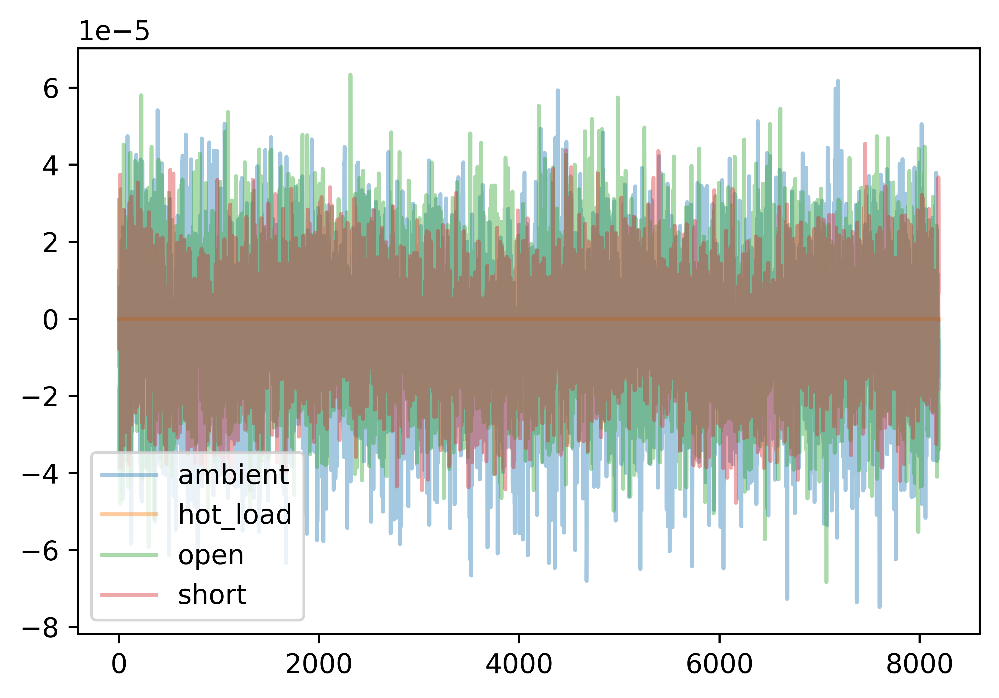

In [22]:
for i, (name, src) in enumerate(calobs._loads.items()):
    plt.plot(src.spectrum.averaged_spectrum/rauls_lab_spectra[:, i+1] - 1, label=name, alpha=0.4)
    
plt.legend()

Check what happens if we inject Raul's averaged spectra:

In [165]:
new = calobs.inject(averaged_spectra = {name: rauls_lab_spectra[:, i+1] for i, name in enumerate(calobs._loads)})

In [25]:
matched_spectra = calobs.inject(
    averaged_spectra = {name: rauls_lab_spectra[:, i+1] for i, name in enumerate(calobs._loads)}
)
matched_spectra_and_s11 = calobs.inject(
    averaged_spectra = {name: rauls_lab_spectra[:, i+1] for i, name in enumerate(calobs._loads)},
    lna_s11=raul_lna,
)

plot_coefficient_comparison(
    {
        "default": calobs, 
        "matched_spectra": matched_spectra,
        'matched spectra and LNA+Ant': matched_spectra
    }, 
    sfinal=sfinal,
    inject_ant_s11=['matched spectra and LNA+Ant']
);

/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,


#### Hot Load Correction Check

In [66]:
raul_hot_load = np.genfromtxt("raul-processing/raul_hot_load_temps.txt")

Text(0, 0.5, 'Corrected Hot load [K]')

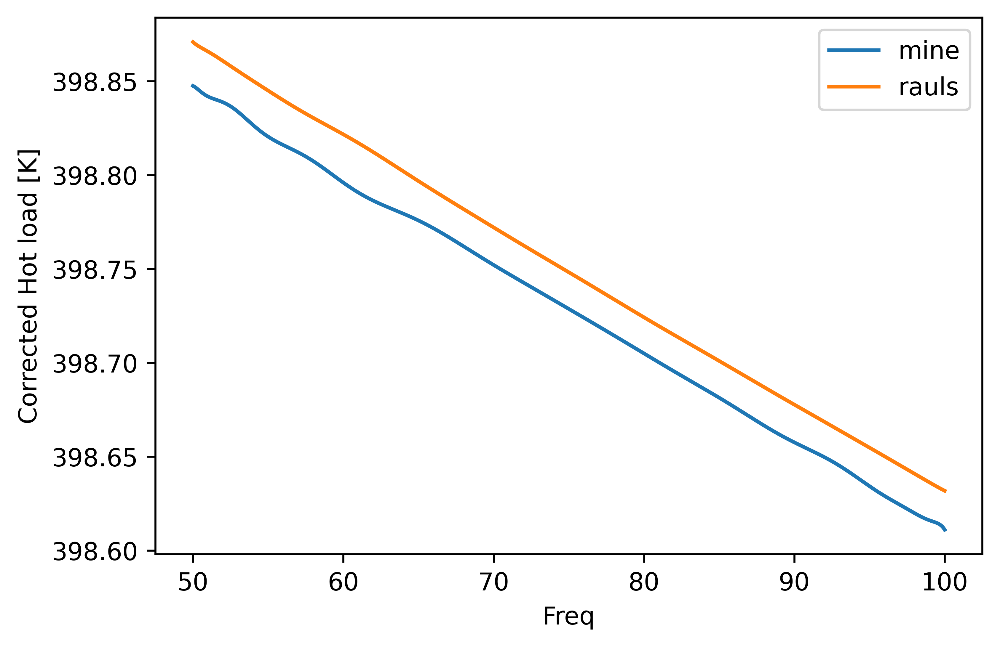

In [24]:
plt.plot(calobs.freq.freq, raul_hot_load[:,1], label='mine')
plt.plot(calobs.freq.freq, calobs.hot_load.temp_ave, label='rauls')
plt.legend()
plt.xlabel("Freq")
plt.ylabel("Corrected Hot load [K]")

In [30]:
match_hot_load = calobs.inject(
    thermistor_temp_ave = {
        name: source.temp_ave if name != 'hot_load' else raul_hot_load[:,1] for name, source in calobs._loads.items()
    }, 
)

matched_hot_load_and_s11 = calobs.inject(
    thermistor_temp_ave = {
        name: source.temp_ave if name != 'hot_load' else raul_hot_load[:,1] for name, source in calobs._loads.items()
    }, 
    lna_s11=raul_lna,
)

plot_coefficient_comparison(
    {"default": calobs, "matched_hot_load": match_hot_load, 'matched_hot_load + LNA+AntS11': matched_hot_load_and_s11}, 
    sfinal=sfinal,
    inject_ant_s11=['matched_hot_load + LNA+AntS11']
);

/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,


#### Antenna S11

In [67]:
raul_ant_s11 = cal_params[:, 8] + 1j*cal_params[:, 9]

/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:74: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:74: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,


Text(0.5, 1.0, 'Antenna S11')

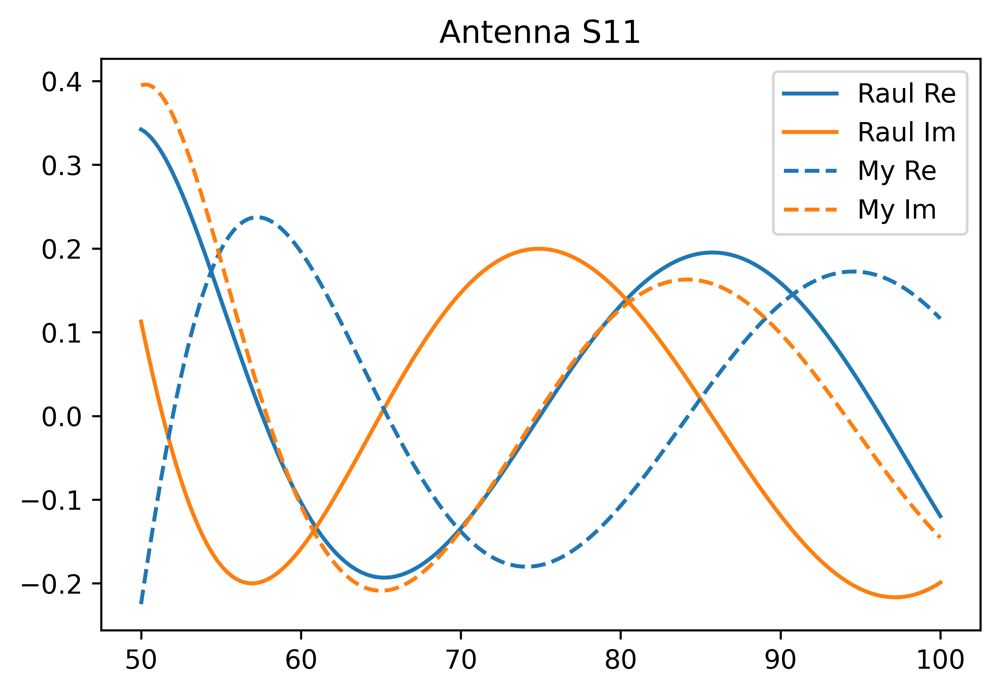

In [17]:
plt.plot(cal_params[:, 0], np.real(raul_ant_s11), color='C0', label='Raul Re')
plt.plot(cal_params[:, 0], np.imag(raul_ant_s11), color='C1', label='Raul Im')
plt.plot(cal_params[:, 0], np.real(labcal.antenna_s11_model(cal_params[:, 0])), ls='--', color='C0', label='My Re')
plt.plot(cal_params[:, 0], np.imag(labcal.antenna_s11_model(cal_params[:, 0])), ls='--', color='C1', label='My Im')
plt.legend()
plt.title("Antenna S11")

/home/smurray/miniconda3/envs/edges/lib/python3.7/site-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


Text(0.5, 1.0, 'Antenna S11 Phase')

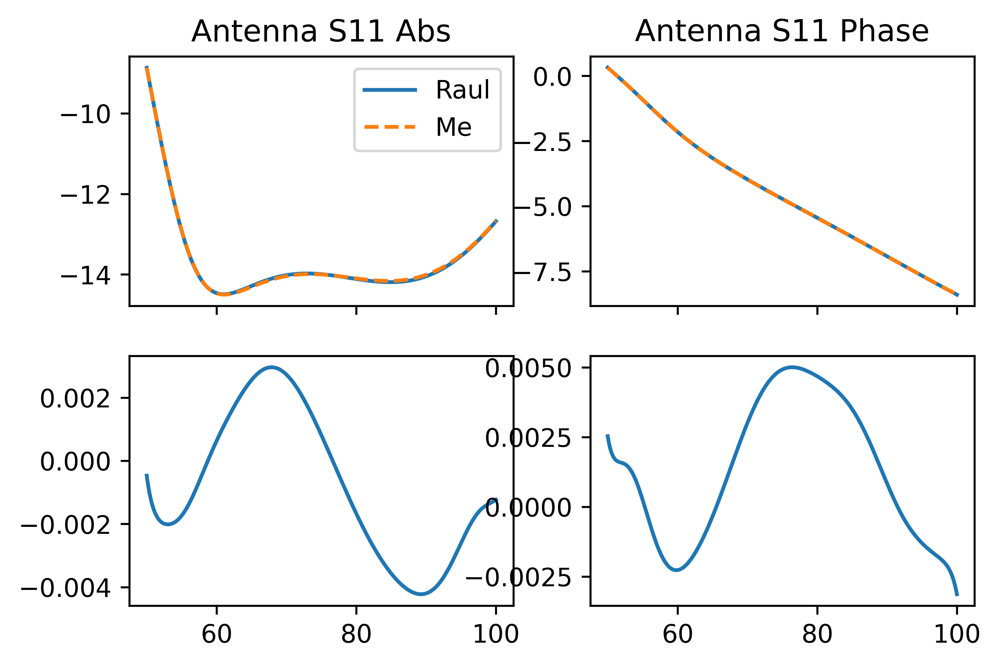

In [29]:
fig, ax = plt.subplots(2, 2, sharex=True)
ax[0, 0].plot(cal_params[:, 0], 20*np.log10(np.abs(raul_ant_s11)),  label='Raul')
ax[0, 1].plot(cal_params[:, 0], np.unwrap(np.angle(raul_ant_s11)), )

ax[1, 0].plot(cal_params[:, 0], np.abs(raul_ant_s11)/np.abs(labcal.antenna_s11_model(cal_params[:, 0])) - 1)

ax[0, 0].plot(cal_params[:, 0], 20*np.log10(labcal.antenna_s11_model(cal_params[:, 0])), ls='--',  label='Me')
ax[0, 1].plot(cal_params[:, 0], np.unwrap(np.angle(labcal.antenna_s11_model(cal_params[:, 0]))), ls='--', )
ax[1, 1].plot(cal_params[:, 0], np.unwrap(np.angle(raul_ant_s11)) - np.unwrap(np.angle(labcal.antenna_s11_model(cal_params[:, 0]))))

ax[0, 0].legend()
ax[0, 0].set_title("Antenna S11 Abs")
ax[0, 1].set_title("Antenna S11 Phase")

#### Semi-Rigid Cable

In [103]:
plot_coefficient_comparison({"edges-cal": calobs, 'rauls_semi': calobs_new_semi}, sfinal=sfinal)

In [18]:
raul_semi_rigid = np.genfromtxt("raul_semi_rigid_cable.txt")
rsr_s11 = raul_semi_rigid[:, 1] + raul_semi_rigid[:, 2]*1j
rsr_s12 = raul_semi_rigid[:, 3]
rsr_s22 = raul_semi_rigid[:, 4] + raul_semi_rigid[:, 5]*1j

In [19]:
!head -1 raul_semi_rigid_cable.txt

# f, real(s11), imag(s11), abs(s21), real(s22), imag(s22)


In [74]:
calobs.hot_load._correction.freq

/home/smurray/miniconda3/envs/edges/lib/python3.7/site-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


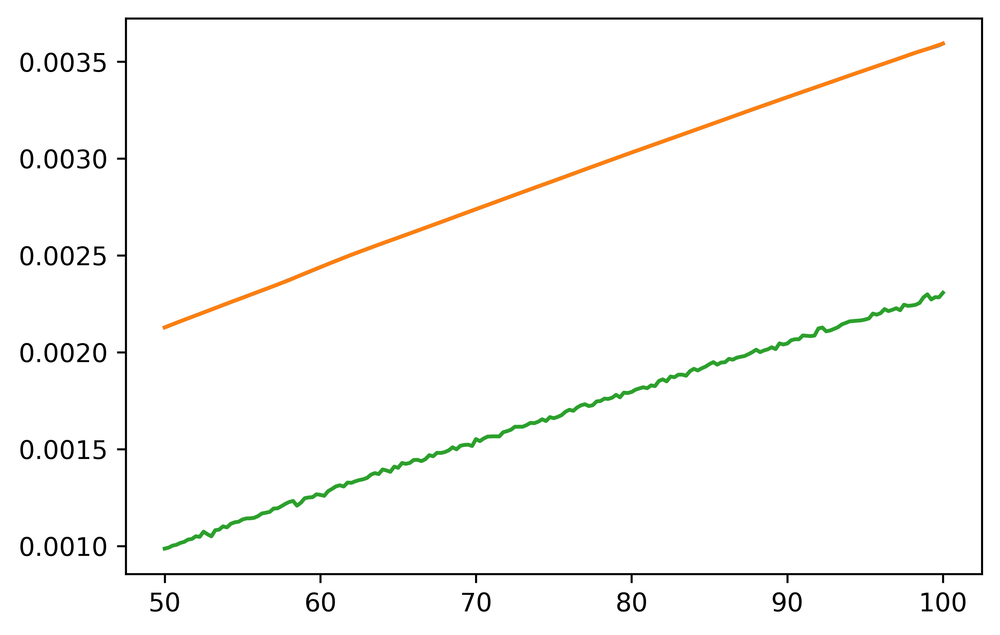

In [75]:
plt.plot(calobs.freq.freq, calobs.hot_load._correction.s11_model(calobs.freq.freq).real)
plt.plot(calobs.hot_load._correction.freq.freq, calobs.hot_load._correction.data[:, 0])

plt.plot(raul_s11_cal['freq'], raul_s11_cal['semi_rigid_s11_re'])

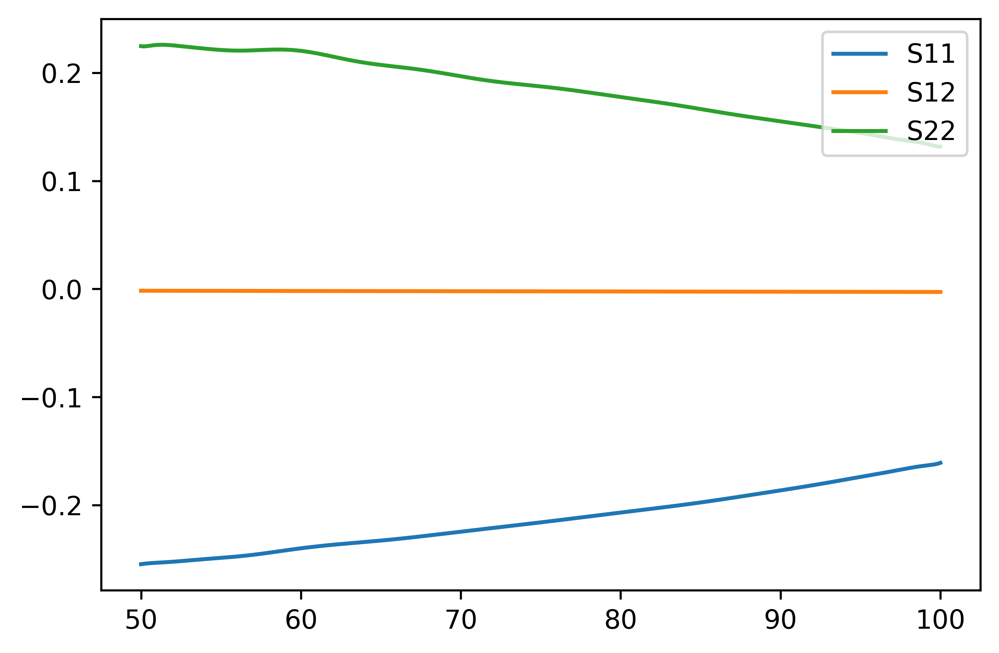

In [20]:
plt.plot(calobs.freq.freq, np.abs(calobs.hot_load._correction.s11_model(calobs.freq.freq))/np.abs(rsr_s11) - 1, label='S11')
plt.plot(calobs.freq.freq, np.abs(calobs.hot_load._correction.s12_model(calobs.freq.freq))/np.abs(rsr_s12) - 1, label='S12')
plt.plot(calobs.freq.freq, np.abs(calobs.hot_load._correction.s22_model(calobs.freq.freq))/np.abs(rsr_s22)- 1, label='S22')
plt.legend()

#### Internal Switch

In [17]:
raul_int_switch = np.genfromtxt("raul_switch_sparams.txt")

In [18]:
!head -1 raul_switch_sparams.txt

# f, real(s11), imag(s11), real(s21), imag(s21), real(s22), imag(s22)


In [19]:
raul_int_switch_s11 = raul_int_switch[:,1] + 1j*raul_int_switch[:, 2]
raul_int_switch_s12 = raul_int_switch[:,3] + 1j*raul_int_switch[:, 4]
raul_int_switch_s22 = raul_int_switch[:,5] + 1j*raul_int_switch[:, 6]

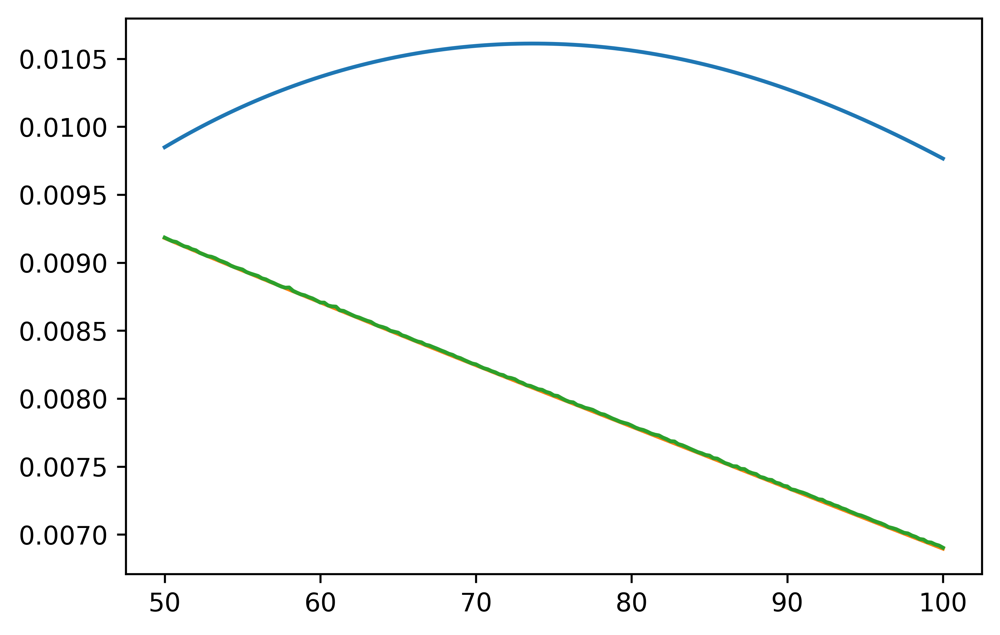

In [20]:
plt.plot(calobs.freq.freq, np.abs(calobs.internal_switch.s11_model(calobs.freq.freq)))
plt.plot(calobs.freq.freq, np.abs(raul_int_switch_s11))
plt.plot(calobs.internal_switch.data.freq, np.abs(calobs.internal_switch.s11_data))

#### Inject Raul's Dataa

In [26]:
plot_coefficient_comparison(
    {"default": calobs, 
     "Match LNA": calobs.inject(lna_s11=raul_lna),
     "Match Spectra": calobs.inject(averaged_spectra = {name: rauls_lab_spectra[:, i+1] for i, name in enumerate(calobs._loads)}),
     "Match HotLoad": calobs.inject(thermistor_temp_ave = {name: source.temp_ave if name != 'hot_load' else raul_hot_load[:,1] for name, source in calobs._loads.items()}),
     "Match NoiseWaves": calobs.inject(
            c1 = cal_params[:, 3],
            c2 = cal_params[:, 4],
            t_unc = cal_params[:, 5],
            t_cos = cal_params[:, 6],
            t_sin = cal_params[:, 7],
        ),
     "Match NW+LNA": calobs.inject(
            lna_s11=raul_lna,
            c1 = cal_params[:, 3],
            c2 = cal_params[:, 4],
            t_unc = cal_params[:, 5],
            t_cos = cal_params[:, 6],
            t_sin = cal_params[:, 7],
        ),
     "Match AntS11": calobs,
     "Match NW+AntS11": calobs.inject(
            c1 = cal_params[:, 3],
            c2 = cal_params[:, 4],
            t_unc = cal_params[:, 5],
            t_cos = cal_params[:, 6],
            t_sin = cal_params[:, 7],
        ),
     "Match LNA+AntS11": calobs.inject(lna_s11=raul_lna),
     "Match NW+LNA+AntS11": calobs.inject(
        lna_s11=raul_lna,
        c1 = cal_params[:, 3],
        c2 = cal_params[:, 4],
        t_unc = cal_params[:, 5],
        t_cos = cal_params[:, 6],
        t_sin = cal_params[:, 7],
    ),
    }, 
    sfinal=sfinal,
    inject_ant_s11=['Match AntS11', "Match NW+AntS11", "Match NW+LNA+AntS11", "Match LNA+AntS11"]
);

/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_sta

In [23]:
match_all = calobs.inject(
    lna_s11=raul_lna,
    c1 = cal_params[:, 3],
    c2 = cal_params[:, 4],
    t_unc = cal_params[:, 5],
    t_cos = cal_params[:, 6],
    t_sin = cal_params[:, 7],
)
plot_coefficient_comparison(
    {"default": calobs, 
     "Match NW+LNA": match_all,
     "Match AntS11": calobs,
     "Match NW+LNA+AntS11": match_all,
    }, 
    sfinal=sfinal,
    inject_ant_s11=['Match AntS11', "Match NW+AntS11", "Match NW+LNA+AntS11"]
);

/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,
/data4/smurray/Projects/radio/EOR/Edges/edges-analysis/src/edges_analysis/analysis/calibrate.py:77: RankWarning: Polyfit may be poorly conditioned
  switch_state_repeat_num=self.switch_state_repeat_num,


#### Summary Differences in Field Data

In [105]:
f, rb, wfinal, sfinal, pb = averaging.bin_spectrum_unbiased_regular(
    params=np.array(model_params),
    resids=resids,
    weights=weights,
    gha= (gha_edges[1:] + gha_edges[:-1])/2,
    gha_bins = np.array([6, 18]),
    model_type='linlog',
    freq=freq,
    resolution=0,
    n_terms=5,
)
sfinal=sfinal[0]
np.savez("rauls-averaged-data.npz", f=f, spec=sfinal)

In [107]:
raul_a_data, raul_b_data = get_linear_coefficients(
    gamma_ant = cal_params[:, 8] + 1j*cal_params[:, 9],
    gamma_rec = cal_params[:, 1] + 1j*cal_params[:, 2],
    sca = cal_params[:,3],
    off = cal_params[:, 4],
    t_unc = cal_params[:, 5],
    t_cos = cal_params[:, 6],
    t_sin = cal_params[:, 7],
) 

In [108]:
raul_a_semi, raul_b_semi = get_linear_coefficients(
    gamma_ant = labcal.antenna_s11,
    gamma_rec = cal_params[:, 1] + 1j*cal_params[:, 2],
    sca = cal_params[:,3],
    off = cal_params[:, 4],
    t_unc = cal_params[:, 5],
    t_cos = cal_params[:, 6],
    t_sin = cal_params[:, 7],
)

In [109]:
a, b = labcal.get_linear_coefficients()
a_s, b_s = labcal_new_semi.get_linear_coefficients()

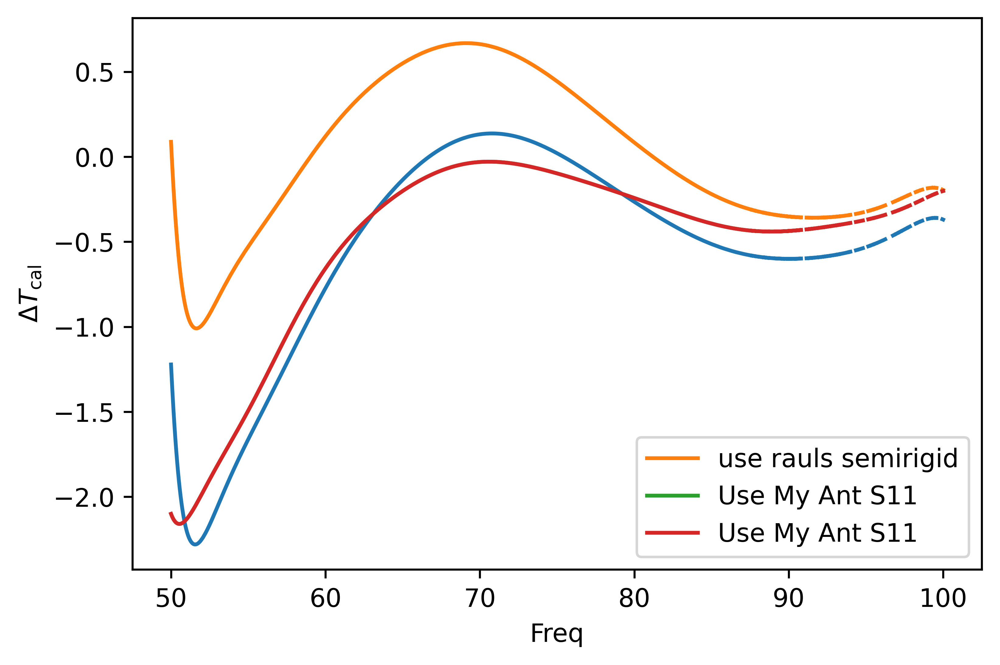

In [117]:
plt.plot(f, sfinal - ((sfinal - raul_b_data)*a/raul_a_data + b))
plt.plot(f, sfinal - ((sfinal - raul_b_data)*a_s/raul_a_data + b_s), label='use rauls semirigid')
plt.xlabel("Freq")
plt.ylabel(r"$\Delta T_{\rm cal}$")
plt.plot(f, sfinal - ((sfinal - raul_b_semi)*a/raul_a_semi + b), label='Use My Ant S11')
plt.plot(f, sfinal - ((sfinal - raul_b_semi)*a/raul_a_semi + b), label='Use My Ant S11')

plt.legend()

In [112]:
my_sfinal = ((sfinal - raul_b_data)*a/raul_a_data + b)
my_sfinal_s = ((sfinal - raul_b_data)*a_s/raul_a_data + b_s)


In [113]:
mask = (f>53) & (f<97)
ff = f[mask]
spec = my_sfinal[mask]

ff = ff[~np.isnan(spec)]
spec = spec[~np.isnan(spec)]


eor = make_absorption(ff, fix=['tau'])
linlog = mdl.LinLog(n_terms=5, default_x=ff)

slf = SemiLinearFit(linlog, eor, spec, 1)
res = slf()

In [118]:
mask = (f>53) & (f<97)
ff = f[mask]
spec_s = my_sfinal_s[mask]

ff = ff[~np.isnan(spec_s)]
spec_s = spec_s[~np.isnan(spec_s)]


eor = make_absorption(ff, fix=['tau'])
linlog = mdl.LinLog(n_terms=5, default_x=ff)

slf_s = SemiLinearFit(linlog, eor, spec_s, 1)
res_s = slf_s()

In [119]:
mask = (f>53) & (f<97)
ff = f[mask]
spec = sfinal[mask]

ff = ff[~np.isnan(spec)]
spec = spec[~np.isnan(spec)]


eor = make_absorption(ff, fix=['tau'])
linlog = mdl.LinLog(n_terms=5, default_x=ff)

raul_slf = SemiLinearFit(linlog, eor, spec, 1)
raul_res = raul_slf()

Text(0.5, 1.0, "Raul's Calibration")

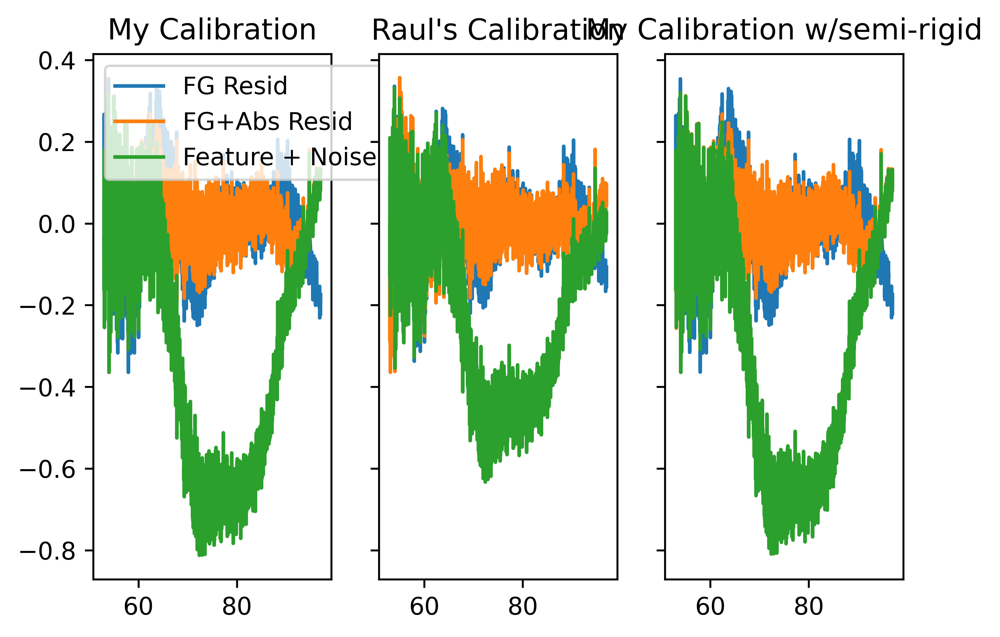

In [120]:
fig, ax = plt.subplots(1, 3, sharey=True)

ax[0].plot(ff, slf.get_resid([0, 75, 20]), label="FG Resid")
ax[0].plot(ff, slf.get_resid(res.x), label="FG+Abs Resid")
ax[0].plot(ff, slf.get_eor(res.x) + slf.get_resid(res.x), label="Feature + Noise")
ax[0].legend()
ax[0].set_title("My Calibration")

ax[2].plot(ff, slf_s.get_resid([0, 75, 20]), label="FG Resid")
ax[2].plot(ff, slf_s.get_resid(res_s.x), label="FG+Abs Resid")
ax[2].plot(ff, slf_s.get_eor(res_s.x) + slf.get_resid(res_s.x), label="Feature + Noise")
ax[2].set_title("My Calibration w/semi-rigid")

ax[1].plot(ff, raul_slf.get_resid([0, 75, 20]), label="FG Resid")
ax[1].plot(ff, raul_slf.get_resid(raul_res.x), label="FG+Abs Resid")
ax[1].plot(ff, raul_slf.get_eor(raul_res.x) + slf.get_resid(raul_res.x), label="Feature + Noise")
ax[1].set_title("Raul's Calibration")


### Do the Bayesian Calibration

#### Maximum-Likelihood Only

In [36]:
est_tns = calobs.C1_poly.coeffs[::-1] * calobs.t_load_ns

cal_lk = NoiseWaveLikelihood.from_calobs(
    calobs,
    t_ns_params = ParamVec(
        't_lns',
        length=calobs.cterms,
        min=est_tns - 100.0,
        max=est_tns + 100.0,
        fiducial = est_tns,
        ref = [stats.norm(v, scale=1.0) for v in est_tns]
    )
)

In [37]:
res = run_map(cal_lk.partial_linear_model)

In [38]:
curves = cal_lk.get_cal_curves(res.x)

Text(0.5, 0.98, 'Calibration Function Estimates')

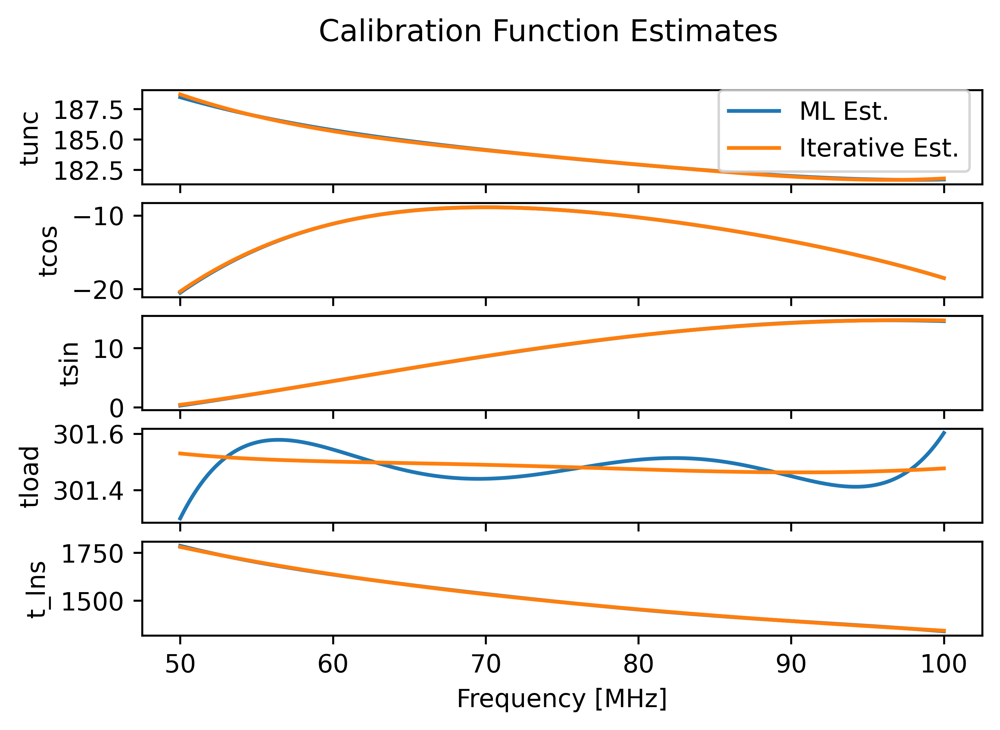

In [39]:
fig, ax = plt.subplots(5, 1, sharex=True)

for i, (name, model) in enumerate(curves.items()):
    ax[i].plot(calobs.freq.freq, model, label='ML Est.')
    ax[i].set_ylabel(name)
    calobs_name = {
        'tunc': 'Tunc',
        'tcos': 'Tcos',
        'tsin': 'Tsin',
        'tload': 'C2',
        't_lns': 'C1'
    }[name]
    
    v = getattr(calobs, calobs_name)()
    
    if calobs_name == 'C2':
        v = calobs.t_load - v
    if calobs_name == 'C1':
        v *= calobs.t_load_ns
        
    ax[i].plot(calobs.freq.freq, v, label='Iterative Est.')
    
ax[0].legend()
ax[-1].set_xlabel("Frequency [MHz]")
fig.suptitle("Calibration Function Estimates")

#### Using emcee

In [32]:
cal_sampler = emcee(cal_lk.partial_linear_model, sampler_kwargs={'nwalkers': 50, 'threads': 24})

In [34]:
mcsamples = cal_sampler.sample(nsteps=2000, progress='notebook')

  0%|          | 0/2000 [00:00<?, ?it/s]

Removed no burn in


In [65]:
mcsamples.saveAsText("emcee_calibration_only")

In [41]:
mcsamples= loadMCSamples("./emcee_calibration_only")

In [51]:
def plot_mc_cal_curves(cal_lk, calobs, samples, indices=None, mc=None):
    fig, ax = plt.subplots(
        5, 1, sharex=True, gridspec_kw={"hspace": 0}, figsize=(10, 8)
    )
    freq = cal_lk.nw_model.freq

    if indices is None:
        indices = list(range(len(samples)))
    if isinstance(indices, int):
        indices = list(range(indices))
        
    fid = cal_lk.get_cal_curves()
    
    if mc is None:
        mc = {name: np.zeros((len(indices), calobs.freq.n)) for name in fid}

        for ix in indices:
            curves = cal_lk.get_cal_curves(samples[ix])
            for name in curves:
                mc[name][-ix] = curves[name]
            
    for i, name in enumerate(fid):
        perc = np.percentile(mc[name], [2, 50, 98], axis=0)
        ax[i].fill_between(freq, perc[0]-perc[1], perc[2]-perc[1], alpha=0.5, label=r'$2\sigma$')
        #ax[i].plot(freq, perc[1], label="Median MCMC")
        ax[i].plot(freq, fid[name]-perc[1], label="MAP")

        ax[i].set_ylabel(name)

    ax[-1].set_xlabel("Frequency [MHz]")
    ax[0].legend()
    return mc

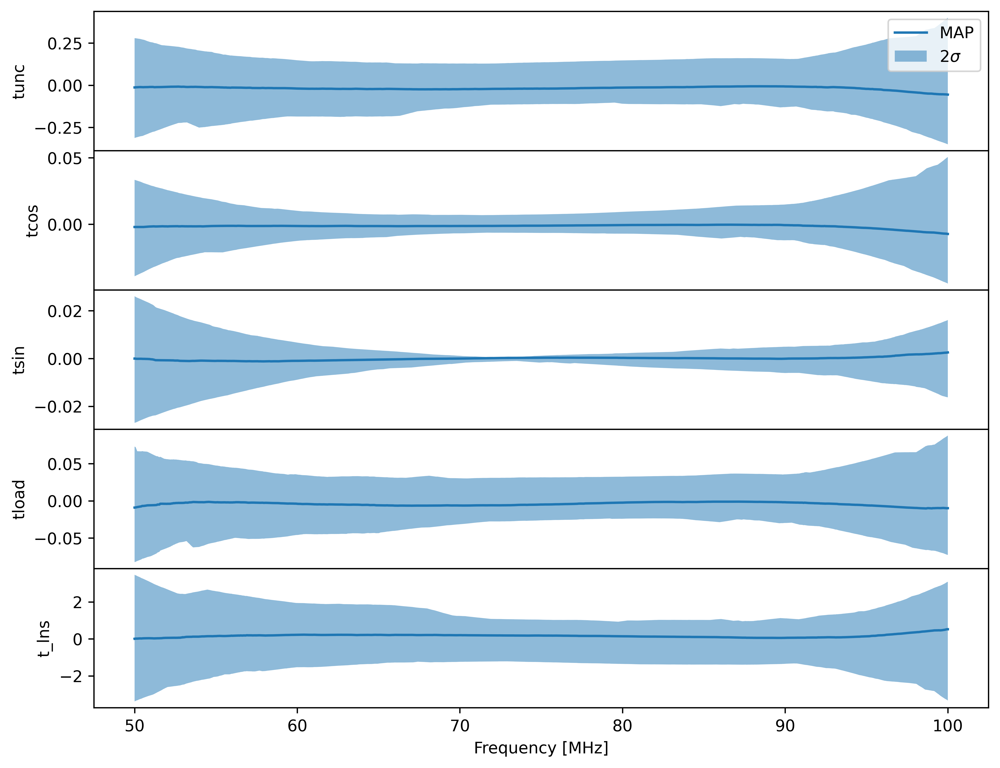

In [52]:
mc = plot_mc_cal_curves(cal_lk, calobs, mcsamples.samples, indices=1000, mc=mc)

[autoreload of edges_estimate.likelihoods failed: Traceback (most recent call last):
  File "/home/smurray/miniconda3/envs/edges/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/home/smurray/miniconda3/envs/edges/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 410, in superreload
    update_generic(old_obj, new_obj)
  File "/home/smurray/miniconda3/envs/edges/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 347, in update_generic
    update(a, b)
  File "/home/smurray/miniconda3/envs/edges/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 317, in update_class
    update_instances(old, new)
  File "/home/smurray/miniconda3/envs/edges/lib/python3.7/site-packages/IPython/extensions/autoreload.py", line 280, in update_instances
    ref.__class__ = new
  File "/home/smurray/miniconda3/envs/edges/lib/python3.7/site-packages/attr/_make.py", line 553, 

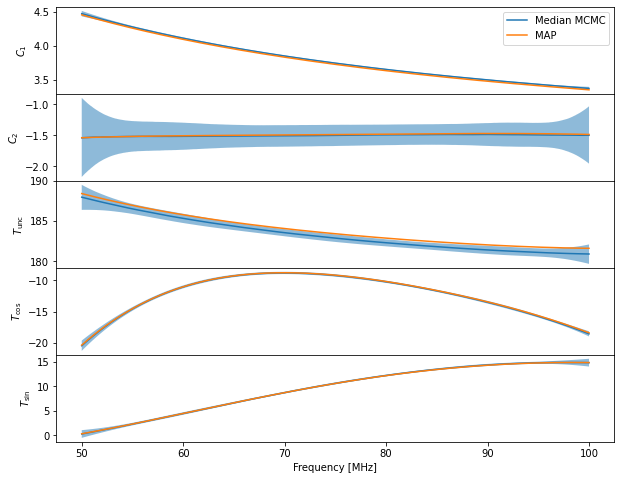

In [11]:
cal_lk.plot_mc_curves(mcsamples.samples)

In [36]:
mcsamples.getMeans()

array([1491.33445705, -203.27965592,   60.43234973,   14.15424467,
         10.97329516,  -34.48555736])

In [37]:
mean_curves = cal_lk.get_cal_curves(mcsamples.getMeans())

In [39]:

newc = calobs.inject(
    c1=mean_curves['t_lns']/calobs.t_load_ns, 
    c2=calobs.t_load - mean_curves['tload'], 
    t_unc = mean_curves['tunc'], 
    t_cos = mean_curves['tcos'], 
    t_sin=mean_curves['tsin']
)

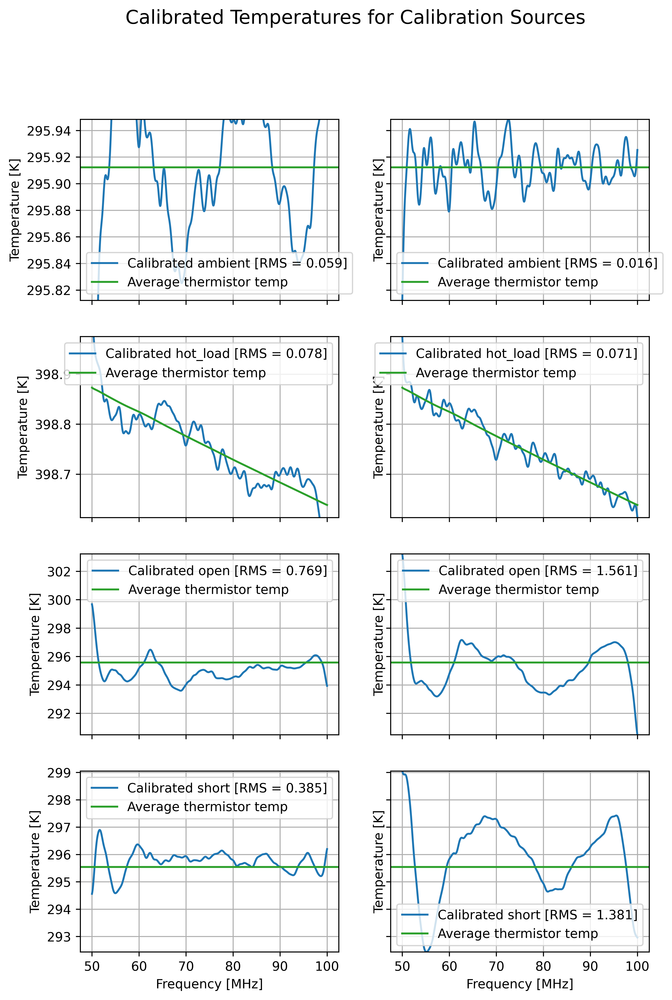

In [40]:
fig, ax = plt.subplots(4, 2, sharex=True, sharey='row', figsize=(8, 12))

newc.plot_calibrated_temps(fig=fig, ax=ax[:, 0])
calobs.plot_calibrated_temps(fig=fig, ax=ax[:, 1]);

## Just FG+Sky

In [35]:
from create_full_likelihood import make_absorption
from edges_estimate.likelihoods import LinearFG
from edges_estimate.eor_models import AbsorptionProfile
from yabf.core.samplers import run_map
from edges_estimate.generate import create_linear_fg_config

In [36]:
avg_data = np.load('rauls-averaged-data.npz')
f = avg_data['f']
sfinal = avg_data['spec']

In [37]:
lk_path, lk = create_linear_fg_config(data=sfinal, freq=f, direc='raul-processing', f_min=53, f_max=97)

Wrote /data4/smurray/Projects/radio/EOR/Edges/bayesian-calibration/raul-processing/linear_fg_53-97MHz_bounds.component.yml
Wrote /data4/smurray/Projects/radio/EOR/Edges/bayesian-calibration/raul-processing/linear_fg_53-97MHz_bounds.likelihood.yml
Wrote /data4/smurray/Projects/radio/EOR/Edges/bayesian-calibration/raul-processing/linear_fg_53-97MHz_bounds.yml


/data4/smurray/Projects/misc/yabf/src/yabf/core/configio.py:91: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  out = yaml.load(fl)


In [38]:
res3 = run_map(lk)

AttributeError: type object 'Model' has no attribute 'get_mdl'

In [24]:
res3

      fun: 3390.8186084328977
 hess_inv: <4x4 LbfgsInvHessProduct with dtype=float64>
      jac: array([-2.10093276e-02, -1.81899055e-03,  4.54747313e-05,  2.81943334e-03])
  message: 'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 115
      nit: 20
     njev: 23
   status: 0
  success: True
        x: array([ 0.38021416, 77.96979585, 10.15719633, 20.30656071])

In [25]:
lk = LinearFG(
    freq=f,
    sigma=0.68,
    fg_terms=5,
    fg_model='linlog',
    data={'spectrum': sfinal},
    components=(eor,)
)

NameError: name 'eor' is not defined

In [20]:
lk.linear_hessian

array([[ 3.15396105e+04, -6.36229658e+03,  2.17724808e+03,
        -6.60647215e+02,  2.34758708e+02],
       [-6.36229658e+03,  2.17724808e+03, -6.60647215e+02,
         2.34758708e+02, -7.96463210e+01],
       [ 2.17724808e+03, -6.60647215e+02,  2.34758708e+02,
        -7.96463210e+01,  2.89575859e+01],
       [-6.60647215e+02,  2.34758708e+02, -7.96463210e+01,
         2.89575859e+01, -1.03417557e+01],
       [ 2.34758708e+02, -7.96463210e+01,  2.89575859e+01,
        -1.03417557e+01,  3.82290289e+00]])

In [21]:
lk.linear_covariance

array([[ 1.54466429e-04,  2.95875845e-04, -3.44120622e-03,
        -6.38892832e-03,  5.46165373e-03],
       [ 2.95875845e-04,  1.58891349e-02,  2.88183728e-02,
        -2.66392174e-01, -6.26074390e-01],
       [-3.44120622e-03,  2.88183728e-02,  2.31688091e-01,
        -3.47274761e-01, -1.88271277e+00],
       [-6.38892832e-03, -2.66392174e-01, -3.47274761e-01,
         5.62987111e+00,  1.27028313e+01],
       [ 5.46165373e-03, -6.26074390e-01, -1.88271277e+00,
         1.27028313e+01,  3.55074944e+01]])

In [19]:
res =run_map(lk)

In [20]:
res

      fun: 3818.5457767803273
 hess_inv: <4x4 LbfgsInvHessProduct with dtype=float64>
      jac: array([ 0.01355147, -0.00213731,  0.00086402,  0.00172804])
  message: b'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 300
      nit: 33
     njev: 60
   status: 0
  success: True
        x: array([ 0.26710228, 78.29408265, 18.98972089, 19.794478  ])

In [50]:
mask = (~np.isnan(sfinal)) & (f>53.0) & (f<97.0)
eor_here = make_absorption(f[mask])

slf = SemiLinearFit(
    fg=mdl.LinLog(n_terms=5).at(x=f[mask]),
    eor=eor_here,
    spectrum=sfinal[mask],
    sigma=0.68*np.ones(len(f[mask]))
)

In [51]:
res2 = slf()

In [52]:
slf.neg_lk(res2.x)

3420.497098273774

In [53]:
res2

      fun: 3420.497098273774
 hess_inv: <4x4 LbfgsInvHessProduct with dtype=float64>
      jac: array([ 0.01878107, -0.0007276 ,  0.        , -0.00318323])
  message: 'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 125
      nit: 21
     njev: 25
   status: 0
  success: True
        x: array([ 0.38092654, 77.97085395, 10.11781371, 20.30635741])

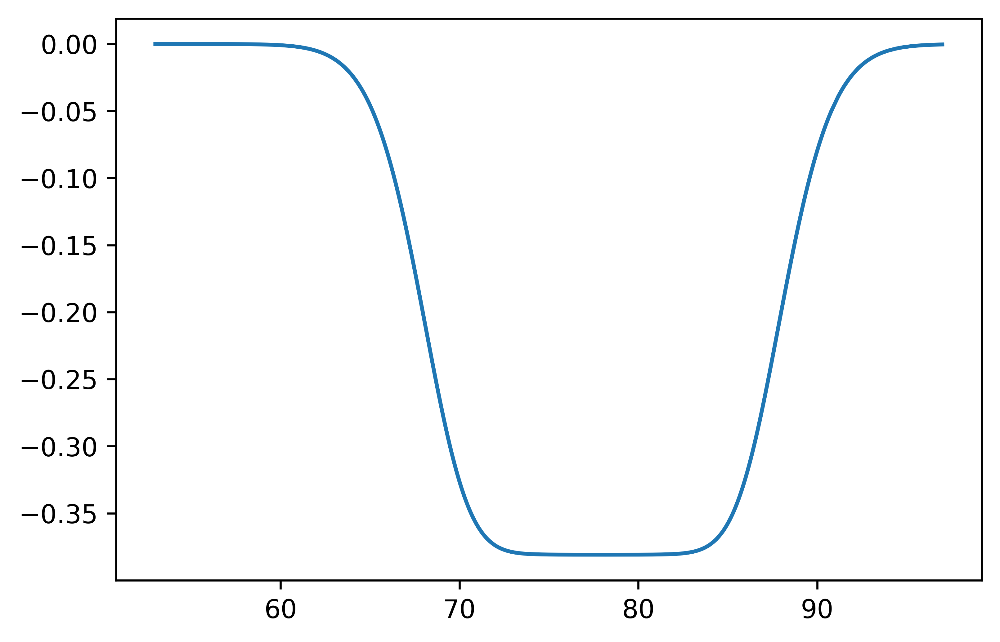

In [56]:
plt.plot(f[mask], slf.get_eor(res2.x))

## Calibration + Sky

### Standard Full Likelihood

In [ ]:
data_lk_real = DataCalibrationLikelihood.from_labcal(
    labcal, 
    q_ant=, 
    qvar_ant=varq, 
    fg_model=fg, 
    eor_components=(eor,),
    sim=False,
    t_ns_params=t_ns_params_real,
)

In [68]:
import sys
sys.path.append("raul-processing")
from create_full_likelihood import create_full_likelihood

In [27]:
f, rb, wfinal, sfinal, pb = averaging.bin_spectrum_unbiased_regular(
    params=np.array(model_params),
    resids=resids,
    weights=weights,
    gha= (gha_edges[1:] + gha_edges[:-1])/2,
    gha_bins = np.array([6, 18]),
    model_type='linlog',
    freq=freq,
    resolution=0,
    n_terms=5,
)
sfinal=sfinal[0]
np.savez("rauls-averaged-data.npz", f=f, spec=sfinal)

In [69]:
avg_data = np.load('rauls-averaged-data.npz')
f = avg_data['f']
sfinal = avg_data['spec']

In [36]:
full_lk_cfg, full_lk = create_full_likelihood(calobs, field_freq=f, field_spec=sfinal, direc='raul-processing')

TypeError: create_full_likelihood() missing 1 required positional argument: 's11_files'

In [13]:
full_lk()

(159448.1573506863, [])

In [82]:
fmask = (f > 53) & (f < 97)
spec = sfinal[fmask]
ff = f[fmask]

ff = ff[~np.isnan(spec)]
spec = spec[~np.isnan(spec)]

eor = make_absorption(ff, fix=['tau'])
linlog = mdl.LinLog(n_terms=5, default_x=ff)

slf = SemiLinearFit(linlog, eor, spec, 1)
res = slf()

In [84]:
res.x

array([ 0.45300714, 78.09070213, 20.6401287 ])

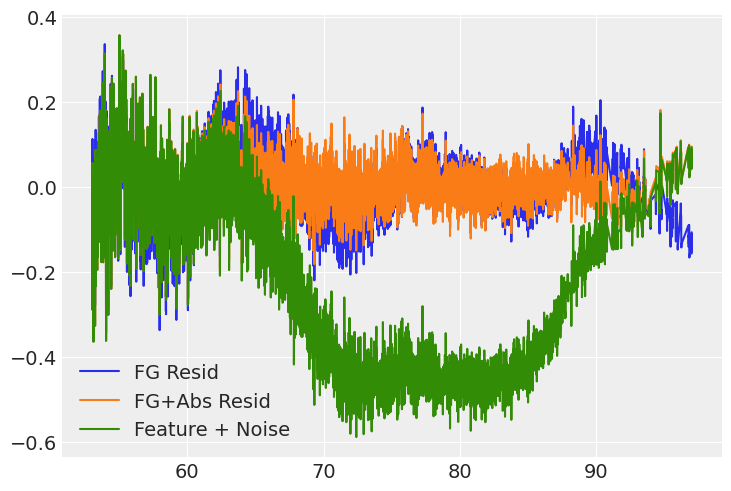

In [83]:
plt.plot(ff, slf.get_resid([0, 75, 20]), label="FG Resid")
plt.plot(ff, slf.get_resid(res.x), label="FG+Abs Resid")
plt.plot(ff, slf.get_eor(res.x) + slf.get_resid(res.x), label="Feature + Noise")
plt.legend()

In [125]:
abs_resid = np.abs(slf.get_resid(res.x))
resid = slf.get_resid(res.x)

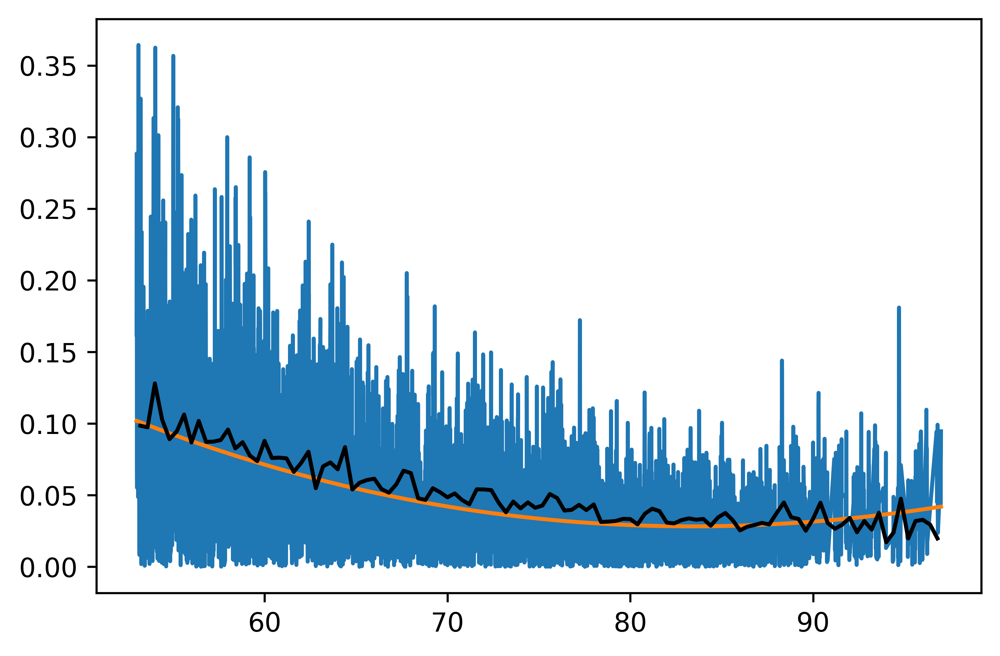

In [131]:
plt.plot(ff, abs_resid)
plt.plot(ff, sig)
plt.plot(fcentres, stds, color='k')

In [126]:
par = np.polyfit(ff, abs_resid, 3)
sig = np.polyval(par, ff)

In [130]:
stds = []
fcentres = []
for fmin in np.arange(ff.min(), ff.max(), 0.4):
    mask = (ff >= fmin) & (ff < fmin + 0.4)
    stds.append(np.std(resid[mask]))
    fcentres.append(fmin + 0.2)

#### Check Live Points

In [31]:
from getdist import MCSamples
import arviz as az

In [16]:
lk = load_likelihood_from_yaml("raul-processing/full-likelihood_50-100MHz.config.yml")

/data4/smurray/Projects/misc/yabf/src/yabf/core/configio.py:91: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  out = yaml.load(fl)


In [28]:
live = np.genfromtxt("raul-processing/full-likelihood_50-100MHz_phys_live.txt")

In [38]:
dataset = az.convert_to_inference_data({name: live[:, i] for i, name in enumerate(lk.child_active_params.keys())})

In [39]:
dataset.posterior.data_vars

Data variables: (12/36)
    C1_0     (chain, draw) float64 3.718 3.72 3.726 3.733 ... 3.666 3.569 3.782
    C1_1     (chain, draw) float64 -0.3339 -0.1333 -0.3634 ... -0.2607 -0.3534
    C1_2     (chain, draw) float64 -0.006659 0.2386 0.0836 ... 0.08939 0.1027
    C1_3     (chain, draw) float64 -0.09003 -0.1628 ... -0.02761 -0.04856
    C1_4     (chain, draw) float64 0.03919 0.1187 ... -0.007626 -0.003667
    C1_5     (chain, draw) float64 -0.01711 -0.02589 0.03618 ... 0.01714 0.06351
    ...       ...
    p3       (chain, draw) float64 -886.2 -1.095e+03 222.9 ... 103.9 368.2
    p4       (chain, draw) float64 34.29 38.37 -83.62 ... -84.85 -76.81 -2.97
    A        (chain, draw) float64 0.7556 0.9251 1.464 ... 1.03 0.5925 1.663
    nu0      (chain, draw) float64 78.25 64.27 64.16 78.03 ... 70.46 65.2 65.0
    tau      (chain, draw) float64 7.757 7.25 4.26 7.306 ... 1.805 7.163 4.433
    w        (chain, draw) float64 23.22 19.76 20.14 22.81 ... 10.61 19.38 19.1

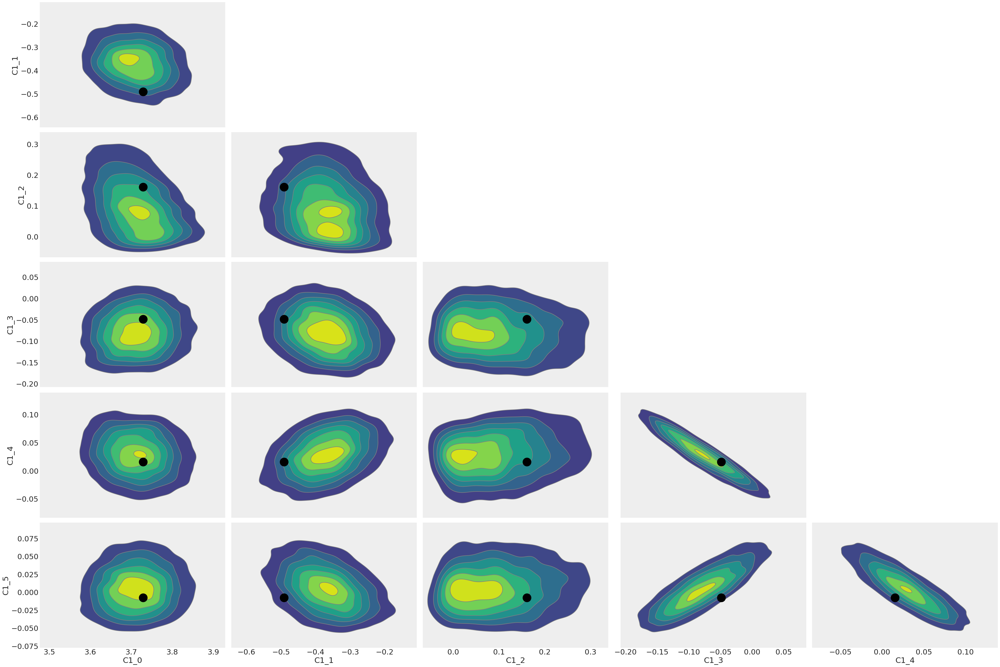

In [47]:
az.style.use("arviz-darkgrid")

az.plot_pair(
    dataset,
    var_names=["C1_0", "C1_1", "C1_2", "C1_3", "C1_4", "C1_5"],
    kind="kde",
    divergences=True,
    textsize=22,
    reference_values={p.name: p.fiducial for p in lk.child_active_params},
    reference_values_kwargs={'markersize': 25, 'color': 'k'}
)

array([[<AxesSubplot:ylabel='C2_1'>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:ylabel='C2_2'>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:ylabel='C2_3'>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:ylabel='C2_4'>, <AxesSubplot:>, <AxesSubplot:>,
        <AxesSubplot:>, <AxesSubplot:>],
       [<AxesSubplot:xlabel='C2_0', ylabel='C2_5'>,
        <AxesSubplot:xlabel='C2_1'>, <AxesSubplot:xlabel='C2_2'>,
        <AxesSubplot:xlabel='C2_3'>, <AxesSubplot:xlabel='C2_4'>]],
      dtype=object)

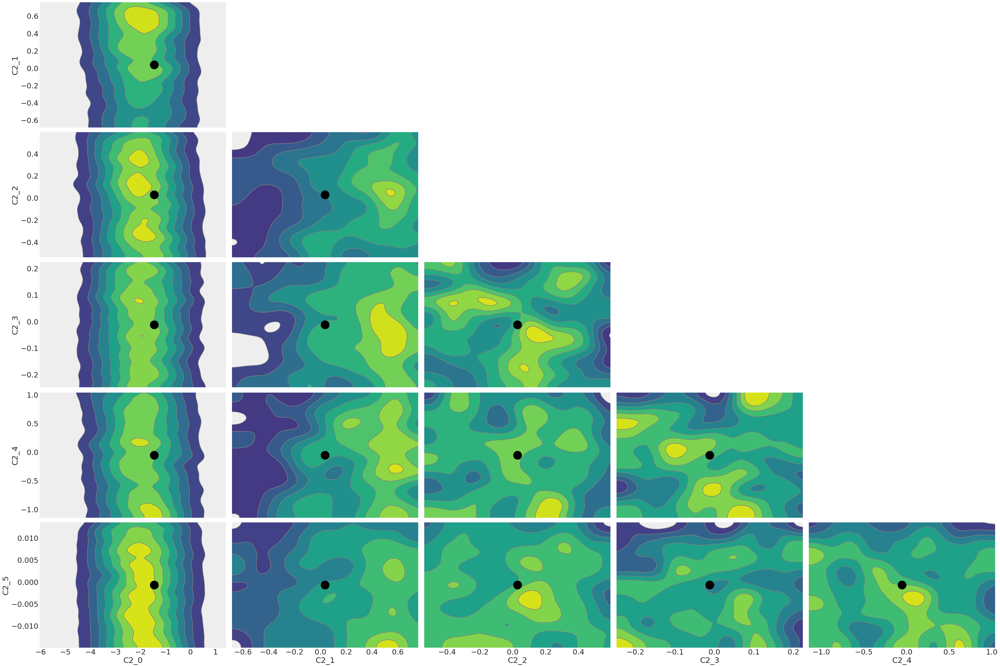

In [48]:
az.plot_pair(
    dataset,
    var_names=["C2_0", "C2_1", "C2_2", "C2_3", "C2_4", "C2_5"],
    kind="kde",
    divergences=True,
    textsize=22,
    reference_values={p.name: p.fiducial for p in lk.child_active_params},
    reference_values_kwargs={'markersize': 25, 'color': 'k'}
);

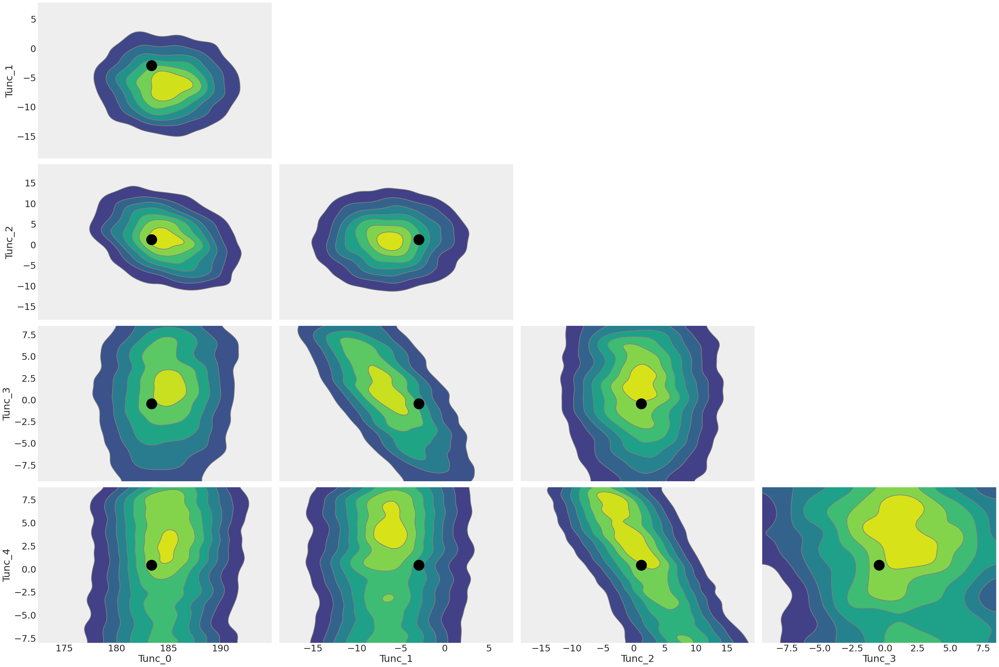

In [49]:
az.plot_pair(
    dataset,
    var_names=["Tunc_0", "Tunc_1", "Tunc_2", "Tunc_3", "Tunc_4"],
    kind="kde",
    divergences=True,
    textsize=22,
    reference_values={p.name: p.fiducial for p in lk.child_active_params},
    reference_values_kwargs={'markersize': 25, 'color': 'k'}
);

/home/smurray/miniconda3/envs/edges/lib/python3.7/site-packages/arviz/plots/pairplot.py:228: UserWarning: Divergences data not found, plotting without divergences. Make sure the sample method provides divergences data and that it is present in the `diverging` field of `sample_stats` or `sample_stats_prior` or set divergences=False
  UserWarning,


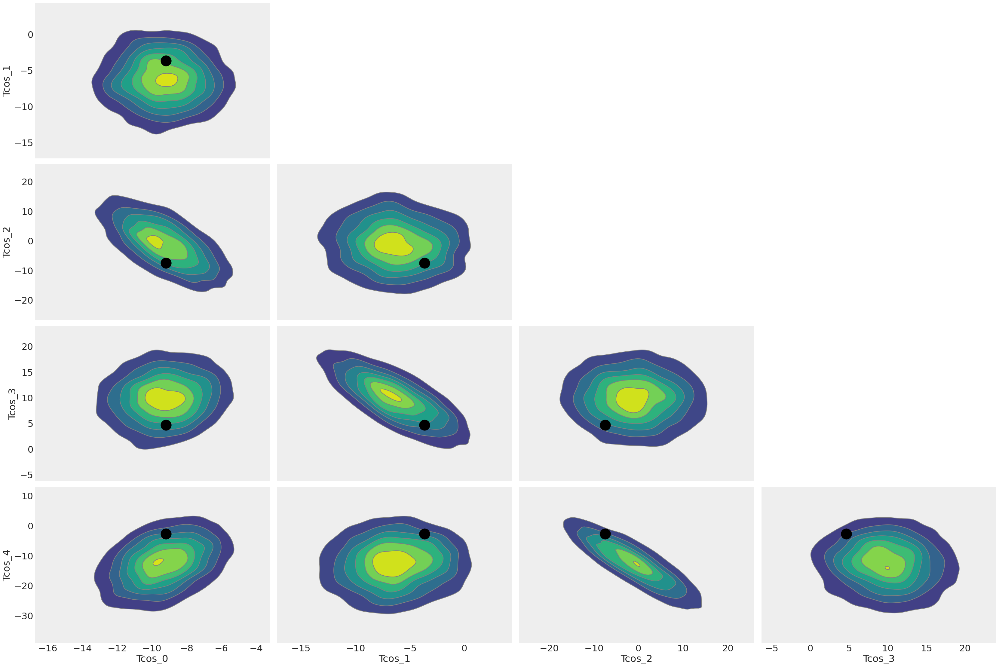

In [52]:
az.plot_pair(
    dataset,
    var_names=["Tcos_0", "Tcos_1", "Tcos_2", "Tcos_3", "Tcos_4"],
    kind="kde",
    divergences=True,
    textsize=22,
    reference_values={p.name: p.fiducial for p in lk.child_active_params},
    reference_values_kwargs={'markersize': 25, 'color': 'k'}
);

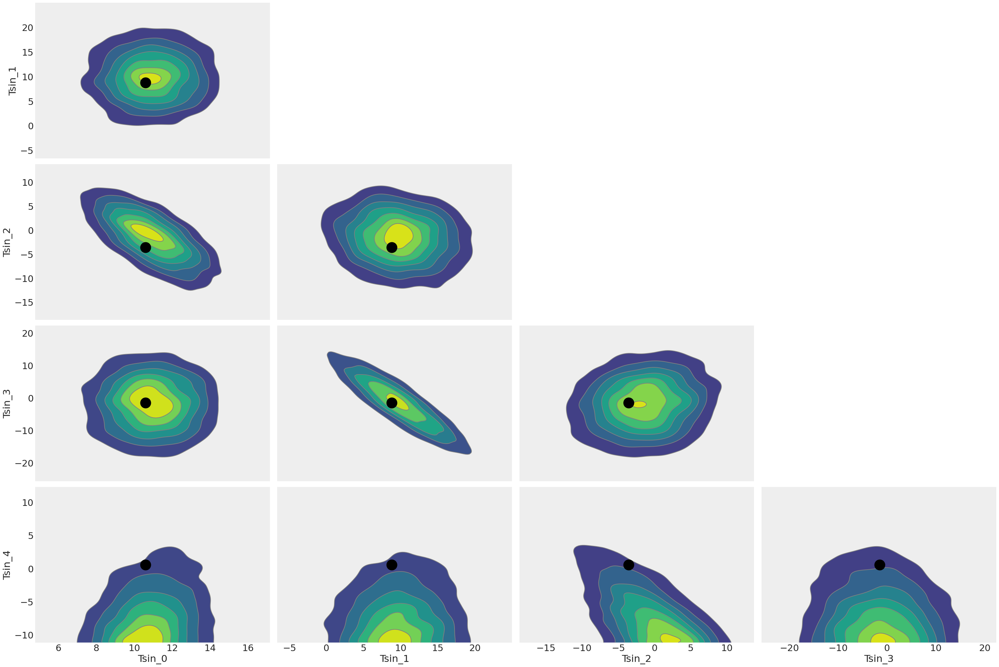

In [53]:
az.plot_pair(
    dataset,
    var_names=["Tsin_0", "Tsin_1", "Tsin_2", "Tsin_3", "Tsin_4"],
    kind="kde",
    divergences=True,
    textsize=22,
    reference_values={p.name: p.fiducial for p in lk.child_active_params},
    reference_values_kwargs={'markersize': 25, 'color': 'k'}
);

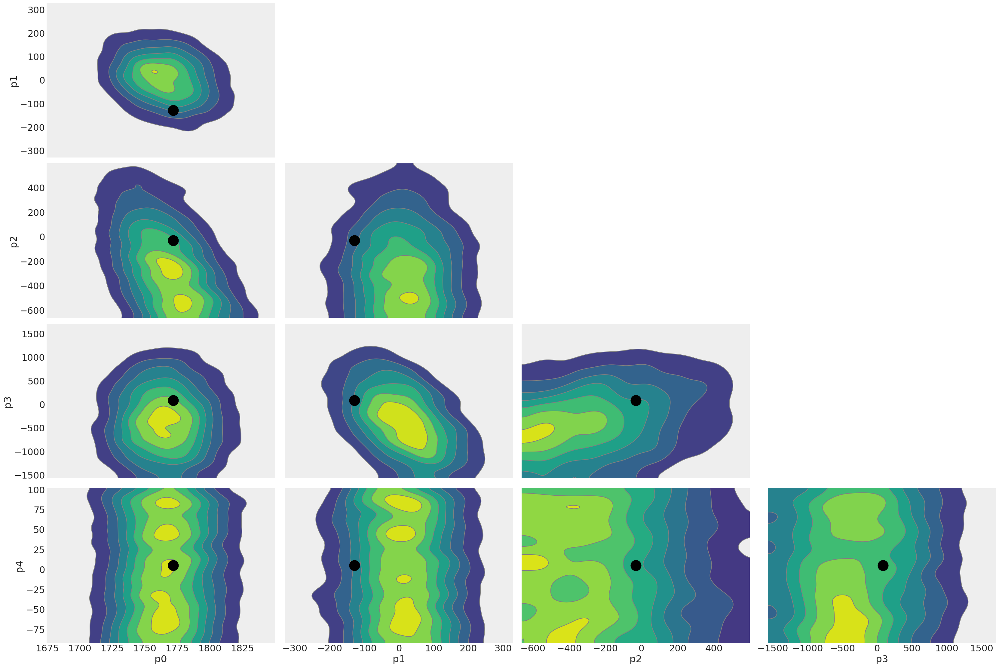

In [55]:
az.plot_pair(
    dataset,
    var_names=["p0", "p1", "p2", "p3", "p4"],
    kind="kde",
    divergences=True,
    textsize=22,
    reference_values={p.name: p.fiducial for p in lk.child_active_params},
    reference_values_kwargs={'markersize': 25, 'color': 'k'}
);

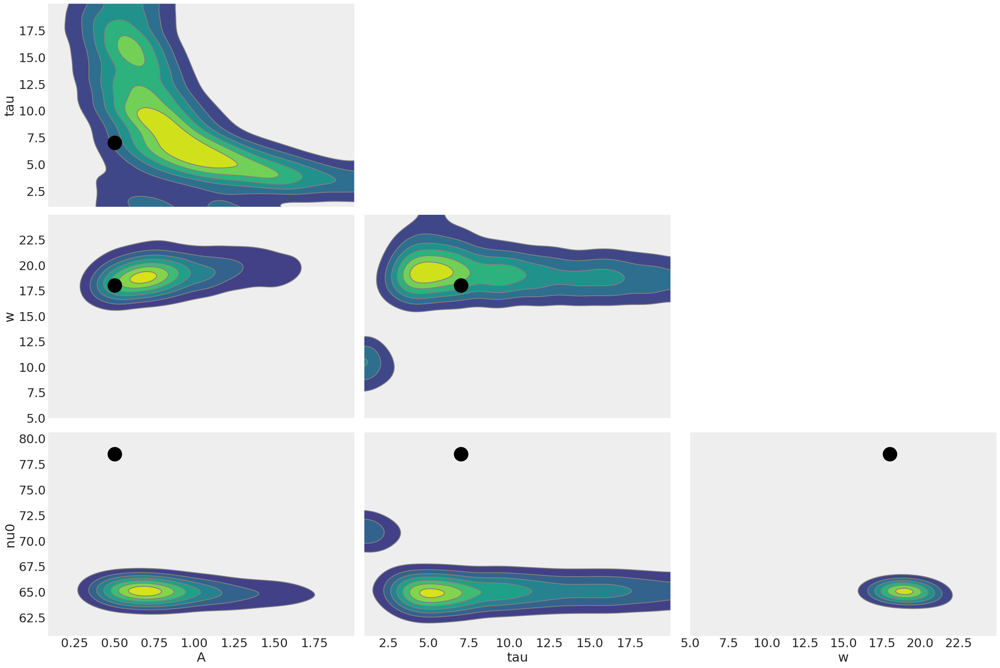

In [57]:
az.plot_pair(
    dataset,
    var_names=["A", "tau", "w", "nu0"],
    kind="kde",
    divergences=True,
    textsize=22,
    reference_values={p.name: p.fiducial for p in lk.child_active_params},
    reference_values_kwargs={'markersize': 25, 'color': 'k'}
);

### Accelerated Likelihood

In [18]:
ra, rb = get_linear_coefficients(
    gamma_ant = cal_params[:, 8] + 1j*cal_params[:, 9],
    gamma_rec = cal_params[:, 1] + 1j*cal_params[:, 2],
    sca = cal_params[:,3],
    off = cal_params[:, 4],
    t_unc = cal_params[:, 5],
    t_cos = cal_params[:, 6],
    t_sin = cal_params[:, 7],
) 

In [19]:
f, resid, wfinal, sfinal, pb = averaging.bin_spectrum_unbiased_regular(
    params=np.array(model_params),
    resids=resids,
    weights=weights,
    gha= (gha_edges[1:] + gha_edges[:-1])/2,
    gha_bins = np.array([6, 18]),
    model=LinLog(n_terms=5),
    freq=freq,
    resolution=0,
)
sfinal=sfinal[0]
np.savez("rauls-averaged-data.npz", f=f, spec=sfinal)

Need to get a reasonable estimate of the variance...

In [20]:
qant = ((sfinal -rb)/ra - calobs.t_load)/calobs.t_load_ns
qmodel = ((LinLog(n_terms=5, parameters=pb[0])(x=freq)-rb)/ra - calobs.t_load)/calobs.t_load_ns

In [21]:
fit = Polynomial(n_terms=25, transform=UnitTransform()).fit(xdata=f, ydata=qant, weights=np.where(np.isnan(qant), 0, 1))

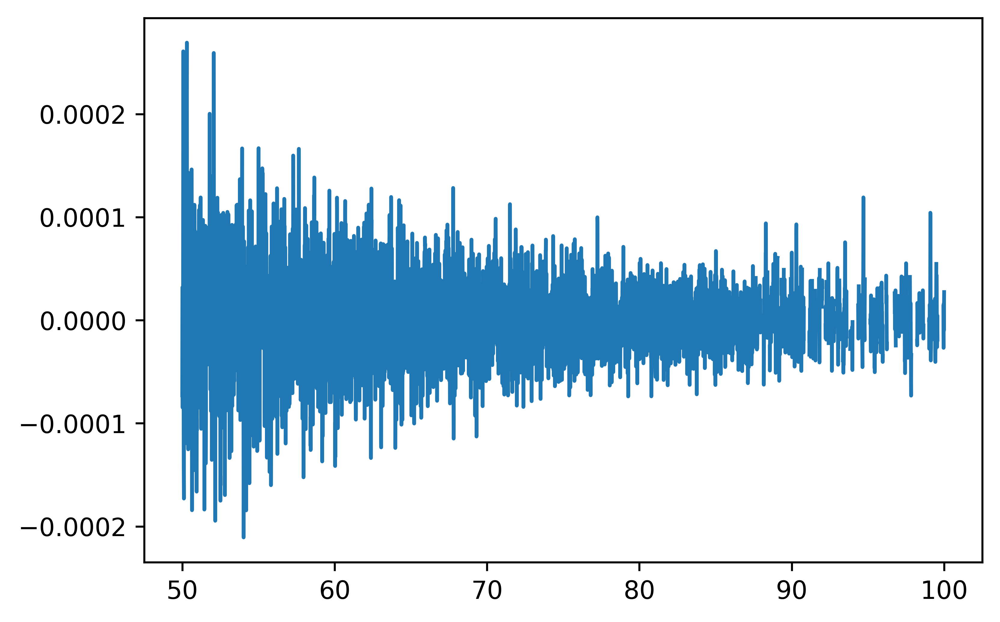

In [22]:
plt.plot(f, fit.residual)

In [23]:
absfit = Polynomial(n_terms=5, transform=UnitTransform()).fit(xdata=f, ydata=np.abs(fit.residual),weights=np.where(np.isnan(qant), 0, 1))

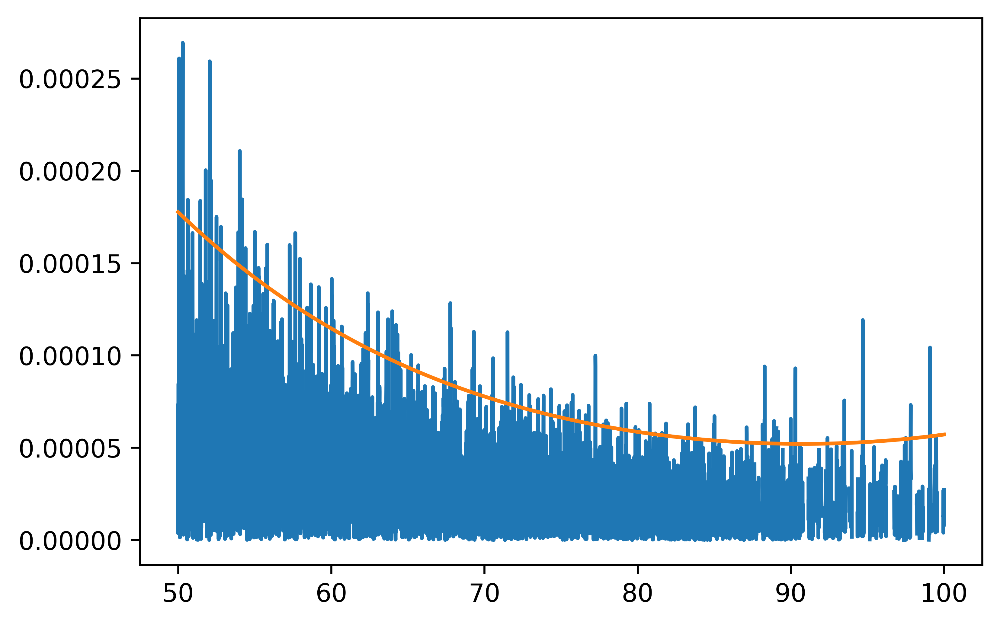

In [24]:
plt.plot(f, np.abs(fit.residual))
plt.plot(f, 3*absfit.evaluate())

In [58]:
mask = (f > 53.) & (f < 97) & ~np.isnan(sfinal)

In [59]:
fg = LinLog(n_terms=5, parameters=[2000, 10, -10, 5, -5])
eor = AbsorptionProfile(
    freqs=f[mask], 
    params={
        "A": {'fiducial': 0.5, 'min': 0, 'max': 5.0, "ref": stats.norm(0.5, scale=0.01) },
        "w": {'fiducial': 15, 'min': 5, 'max': 25, "ref": stats.norm(15, scale=0.1)},
        "tau": {'fiducial': 5, 'min': 0, 'max': 20, "ref": stats.norm(5, scale=0.1)},
        "nu0": {'fiducial': 78, 'min': 60, 'max': 90, 'ref': stats.norm(78, scale=0.1)},
    }
)

In [60]:
est_tns = calobs.C1_poly.coeffs[::-1] * calobs.t_load_ns

t_ns_params = ParamVec(
    't_lns',
    length=calobs.cterms,
    min=est_tns - 100.0,
    max=est_tns + 100.0,
    fiducial = est_tns,
    ref = [stats.norm(v, scale=1.0) for v in est_tns]
)

In [61]:
data_lk = DataCalibrationLikelihood.from_labcal(
    labcal, 
    field_freq=f[mask],
    q_ant=qant[mask], 
    qvar_ant=np.where(np.isnan(qant), np.inf, absfit.evaluate()**2)[mask], 
    fg_model=fg, 
    eor_components=(eor,),
    sim=False,
    t_ns_params=t_ns_params,
)

In [62]:
res_data = run_map(data_lk.partial_linear_model)

In [63]:
res_data

      fun: 35608.43168220203
 hess_inv: <10x10 LbfgsInvHessProduct with dtype=float64>
      jac: array([8.59954525e+00, 2.08557884e+01, 1.05559584e+01, 6.85977227e+00,
       1.84423682e+01, 2.89612219e+01, 1.77874943e+04, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00])
  message: 'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 715
      nit: 40
     njev: 65
   status: 0
  success: True
        x: array([ 1.49133237e+03, -1.95866162e+02,  6.09122222e+01, -1.99718172e+01,
        1.02110100e+01, -3.83079165e+00,  2.00000000e-08,  1.29404406e+01,
        5.83641109e+00,  7.71330891e+01])

In [31]:
def view_results(lk, res_data, calobs=calobs):
    eorspec = lk.partial_linear_model.get_ctx(params=res_data.x)

    fig, ax = plt.subplots(2, 2, figsize=(15, 7), sharex=True)

    sim_tns = calobs.C1()*calobs.t_load_ns
        
    nu = calobs.freq.freq
    
    ax[0, 0].plot(nu, eorspec['tns'], label='Estimated')
    ax[0, 0].plot(nu,sim_tns, label='input')
    ax[1, 0].plot(nu,eorspec['tns'] - sim_tns, color='k', label=r"$\Delta T_{\rm NS}$")
    #ax[1, 0].plot(nu,(eorspec['tns'] - sim_tns)*lk.data['q']['ant'], color='r', label=r"$\Delta T_{\rm NS} Q_{\rm ant}$")
    ax[0, 0].set_title(r"$T_{\rm NS}$")
    ax[0, 0].set_ylabel("Temperature [K]")
    
    nu = lk.nwfg_model.field_freq
    
    ax[0, 1].plot(nu,eorspec['eor_spectrum'])
    ax[0, 1].plot(nu,eor()['eor_spectrum'])
    ax[0, 1].set_title(r"$T_{21}$")
    ax[1, 1].plot(nu,eorspec['eor_spectrum'] - eor()['eor_spectrum'], color='k')
    ax[1, 0].set_ylabel("Difference [K]")
    
    ax[1, 0].set_xlabel("Frequency")
    ax[1, 1].set_xlabel("Frequency")
    
    ax[0, 0].legend()
    ax[1, 0].legend()

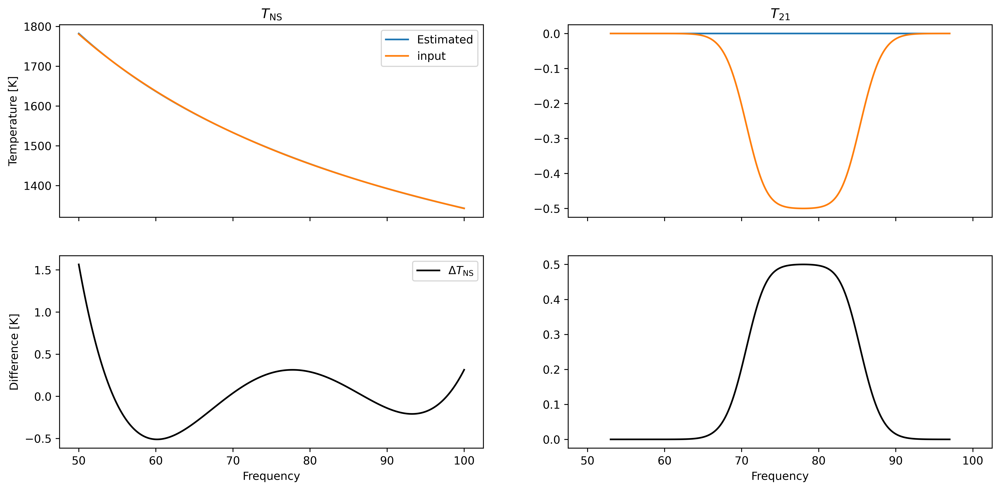

In [54]:
view_results(data_lk, res_data)

This is not particularly good... why not?

Try calibrating with the best-fit calibration, then fitting foregrounds and T21:

In [64]:
fit, data, var = data_lk.partial_linear_model.reduce_model(params=res_data.x)

In [93]:
spec = data_lk.calibrate_at_params(params=res_data.x)

slf = SemiLinearFit(
    fg = LinLog(n_terms=5).at(x=f[mask]),
    eor = eor, 
    spectrum=spec[mask2],
    sigma=np.ones_like(f[mask])
)

In [94]:
data_lk.data['q']['ant'].shape

(6359,)

In [95]:
res2 = slf()

In [96]:
res2

      fun: 5859.374953358133
 hess_inv: <4x4 LbfgsInvHessProduct with dtype=float64>
      jac: array([-3.71983333e-02, -2.72848388e-04, -9.09494627e-05,  4.82032495e-03])
  message: 'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 150
      nit: 25
     njev: 30
   status: 0
  success: True
        x: array([ 0.28897173, 18.4746507 , 10.54768709, 77.64561771])

In [98]:
slf_orig = SemiLinearFit(
    fg = LinLog(n_terms=5).at(x=f[mask]),
    eor = eor, 
    spectrum=sfinal[mask],
    sigma=np.ones_like(f[mask])
)

In [99]:
res3 = slf_orig()

In [100]:
res3

      fun: 5857.122234780106
 hess_inv: <4x4 LbfgsInvHessProduct with dtype=float64>
      jac: array([-5.27506927e-03,  8.18545164e-04,  9.09494627e-05, -4.54747636e-04])
  message: 'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 140
      nit: 21
     njev: 28
   status: 0
  success: True
        x: array([ 0.3811129 , 20.31052931, 10.10073816, 77.97135691])

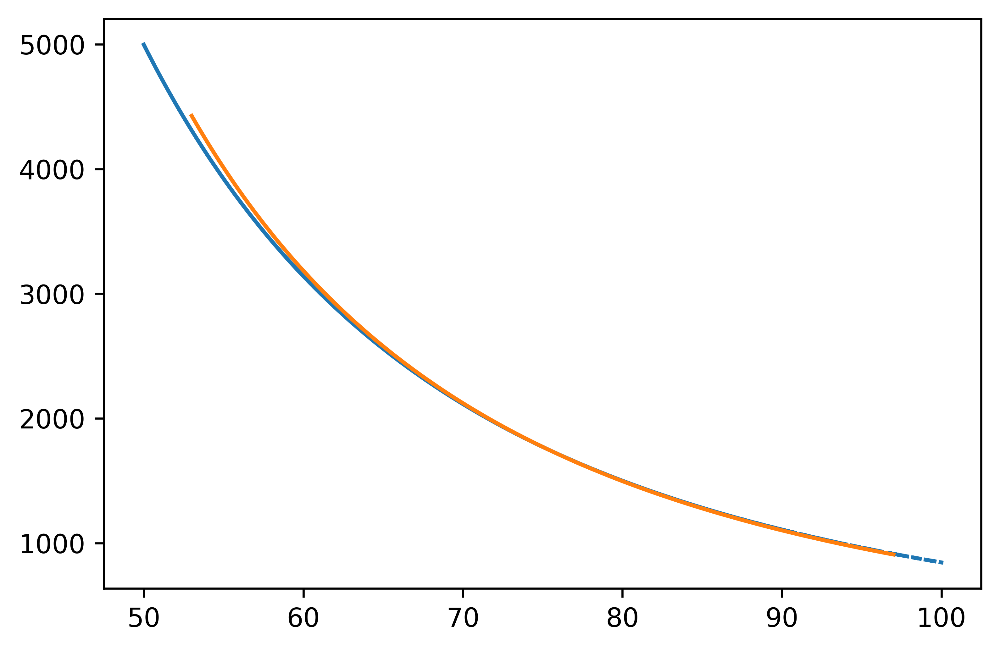

In [97]:
plt.plot(f, sfinal)
plt.plot(f[mask], spec)

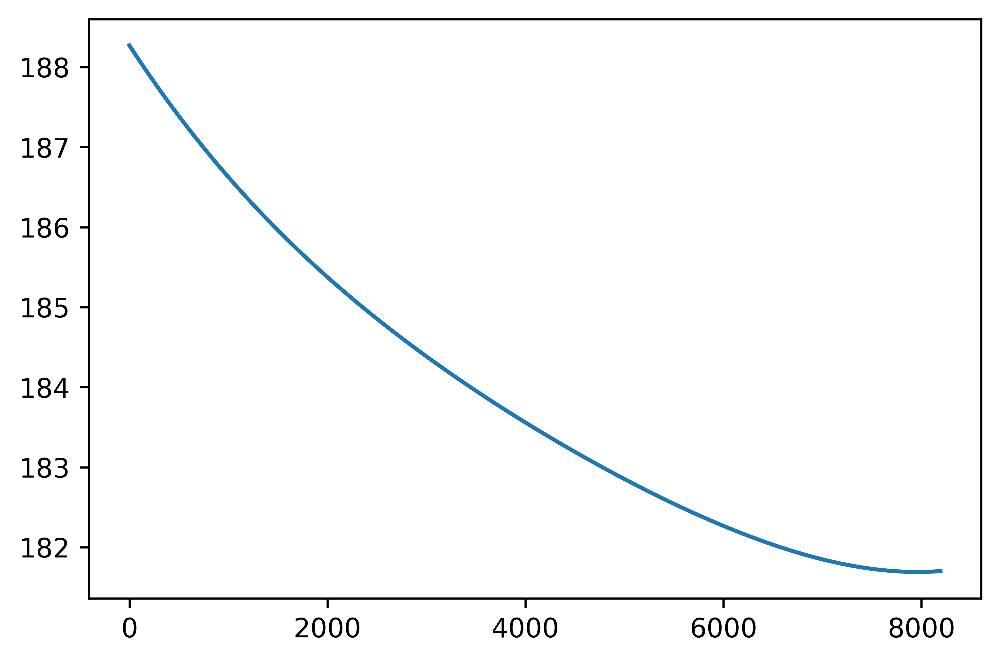

In [68]:
plt.plot(fit.fit.model.tunc(calobs.freq.freq))

#### Higher cterms/wterms

In [42]:
calobs_high = CalibrationObservation(
    "/data5/edges/data/CalibrationObservations/Receiver01/Receiver01_25C_2015_09_02_040_to_200MHz/", 
    f_low=50.0,
    f_high=100.0,
    run_num={"receiver_reading": 6},
    repeat_num=1,
    cterms=15,
    wterms=15,
    load_kwargs= {"t_load": 300, "t_load_ns": 350},
    load_spectra = {
        "hot_load": {"ignore_times_percent": 10},
        "ambient": {"ignore_times_percent": 7},
        "open": {"ignore_times_percent": 7},
        "short": {"ignore_times_percent": 7},
    },
    load_s11s = {"lna":{'n_terms': 11, 'model_type': 'polynomial'}}
)


labcal_high = LabCalibration(
    calobs=calobs_high, s11_files=sorted(Path('/data5/edges/data/S11_antenna/low_band/20160830_a/s11').glob('*.s1p'))
)

In [43]:
est_tns = calobs_high.C1_poly.coeffs[::-1] * calobs.t_load_ns

t_ns_params = ParamVec(
    't_lns',
    length=calobs_high.cterms,
    min=est_tns - 100.0,
    max=est_tns + 100.0,
    fiducial = est_tns,
    ref = [stats.norm(v, scale=1.0) for v in est_tns]
)

In [44]:
data_lk_high = DataCalibrationLikelihood.from_labcal(
    labcal_high, 
    field_freq=f,
    q_ant=qant, 
    qvar_ant=np.where(np.isnan(qant), np.inf, absfit.evaluate()**2), 
    fg_model=fg, 
    eor_components=(eor,),
    sim=False,
    t_ns_params=t_ns_params,
)

In [45]:
res_high = run_map(data_lk_high.partial_linear_model)

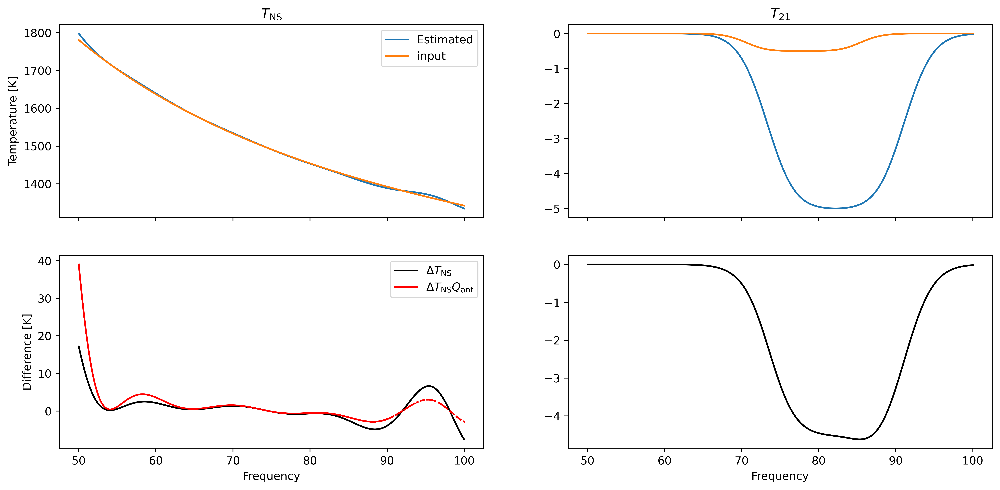

In [46]:
view_results(data_lk_high, res_high)